In [4]:
# prompt: write a code to take images from mydrive

from google.colab import drive
drive.mount('/content/drive')



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
import requests
import os
from PIL import Image
import matplotlib.pyplot as plt

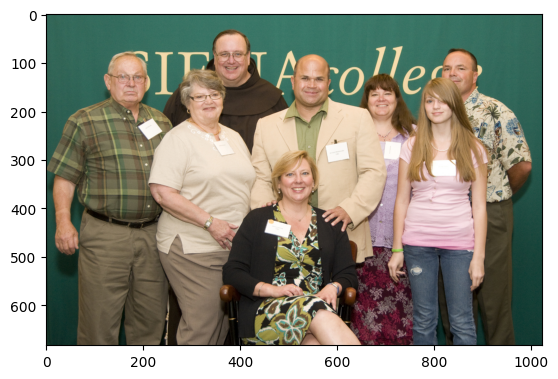

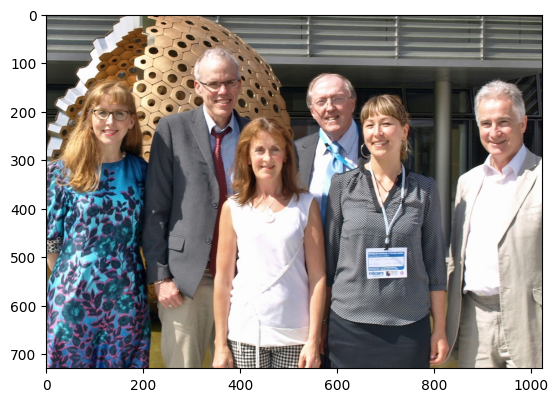

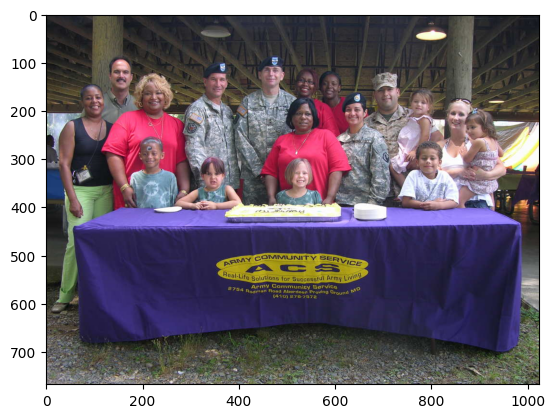

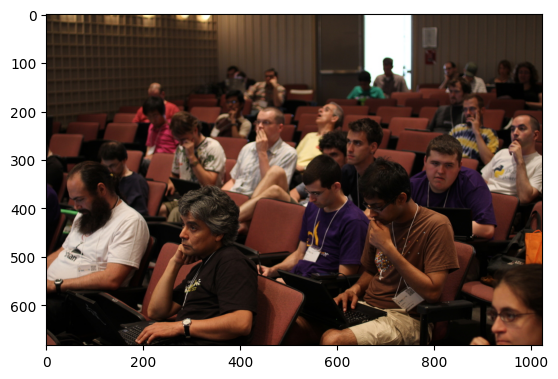

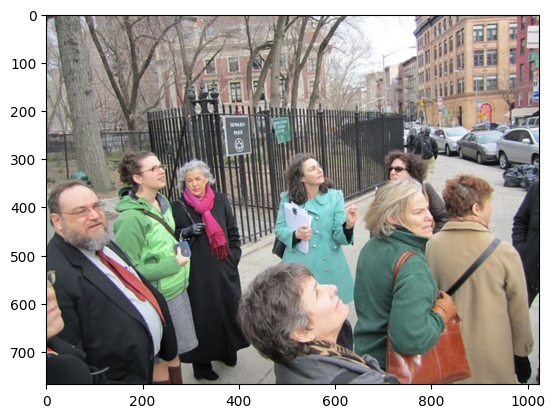

...

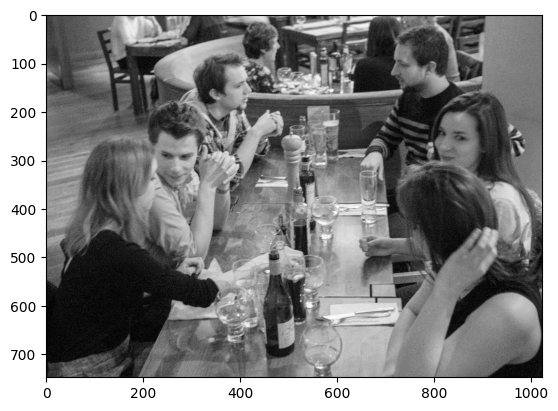

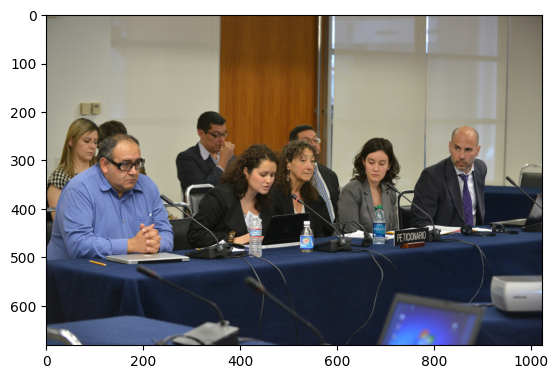

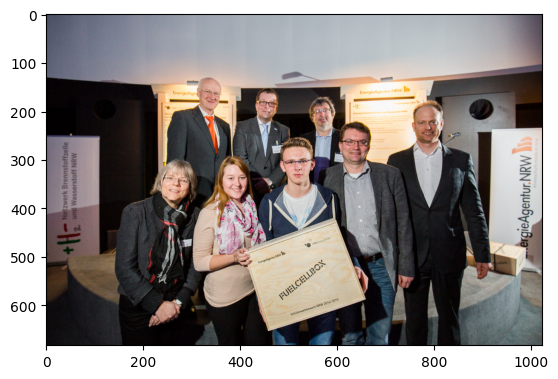

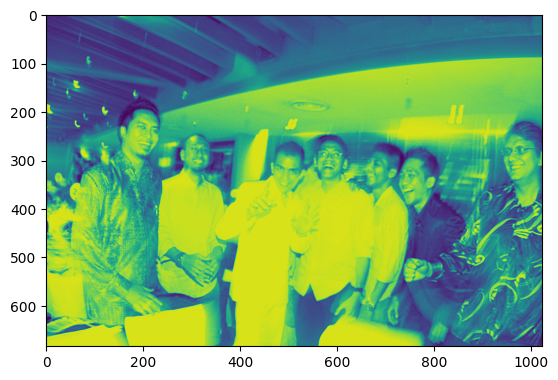

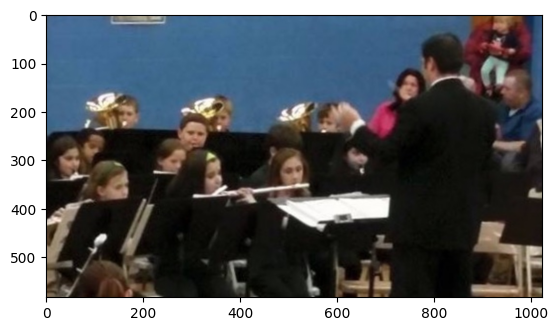

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Specify the path to your image folder in Google Drive
image_folder_path = '/content/drive/MyDrive/Images/dataset_final'

# List all files in the folder
image_files = [f for f in os.listdir(image_folder_path) if os.path.isfile(os.path.join(image_folder_path, f))]

# Loop through the image files and load them using PIL
for image_file in image_files:
  image_path = os.path.join(image_folder_path, image_file)
  try:
    img = Image.open(image_path)
    # You can perform operations on the image here, like displaying it
    plt.imshow(img)
    plt.show()
  except Exception as e:
    print(f"Error loading image {image_file}: {e}")

In [4]:
pip install ultralytics


In [5]:

import cv2
import pandas as pd
from ultralytics import YOLO



# Load the pre-trained YOLOv5 model (specifically the small version for fast detection)
model = YOLO('yolov5s.pt')  # Change to a larger YOLO model for better performance if needed

# Specify the path to your image folder in Google Drive
image_folder_path = '/content/drive/MyDrive/Images/dataset_final'  # Replace with your actual folder path

# List all files in the folder and sort them numerically (to handle the image order)
image_files = sorted(
    [f for f in os.listdir(image_folder_path) if os.path.isfile(os.path.join(image_folder_path, f))],
    key=lambda x: int(os.path.splitext(x)[0])  # Sorting by numerical order based on the file name (e.g., 1.jpg, 2.jpg)
)

# DataFrame to store image names and the number of faces detected
face_count_data = []

# Function to detect faces using YOLO
def detect_faces(image_path):
    # Read the image using OpenCV
    img = cv2.imread(image_path)

    # Perform object detection (YOLO) on the image
    results = model(img)  # Perform inference on the image

    # Extract the detections and get the class ids (person class is generally 0 in YOLO)
    detections = results[0].boxes  # Accessing boxes from the first result

    # Filter for persons (class 0 is 'person')
    faces = [box for box in detections if box.cls == 0]  # cls == 0 corresponds to 'person'

    return len(faces)

# Loop through the image files and count faces in each image
for i, image_file in enumerate(image_files):
    if i >= 50:
        break  # Process only the first 50 images

    image_path = os.path.join(image_folder_path, image_file)

    try:
        num_faces = detect_faces(image_path)
        face_count_data.append({'image_name': image_file, 'num_faces': num_faces})
        print(f"{image_file}: {num_faces} faces detected")
    except Exception as e:
        print(f"Error processing image {image_path}: {e}")

# Convert the face count data into a DataFrame
df = pd.DataFrame(face_count_data)

# Specify the output path on Google Drive
output_csv_path = '/content/drive/MyDrive/Images/output_files/face_counts_yolo.csv'

# Save the DataFrame to a CSV file in Google Drive
df.to_csv(output_csv_path, index=False)

print(f"Face count data saved to {output_csv_path}")


PRO TIP 💡 Replace 'model=yolov5s.pt' with new 'model=yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.


0: 512x640 9 persons, 1066.2ms
Speed: 6.7ms preprocess, 1066.2ms inference, 3.0ms postprocess per image at shape (1, 3, 512, 640)
1.jpg: 9 faces detected

0: 384x640 14 persons, 1 chair, 592.9ms
Speed: 6.5ms preprocess, 592.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
2.jpg: 14 faces detected

0: 448x640 8 persons, 1 tie, 817.5ms
Speed: 5.4ms preprocess, 817.5ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)
3.jpg: 8 faces detected

0: 480x640 6 persons, 1 bottle, 1 wine glass, 1601.2ms
Speed: 6.1ms preprocess, 1601.2ms inference, 15.2ms postprocess per image at shape (1, 3, 480, 640)
4.jpg: 6 faces detected

0: 640x448 6 persons, 1556.7ms
Speed: 8.1ms preprocess, 1556.7ms inference, 16.2ms 

In [ ]:
print(df)

   image_name  num_faces
0       1.jpg          9
1       2.jpg         14
2       3.jpg          8
3       4.jpg          6
4       5.jpg          6
5       6.jpg         18
6       7.jpg          6
7       8.jpg         11
8       9.jpg          8
9      10.jpg          9
10     11.jpg          6
11     12.jpg         13
12     13.jpg         12
13     14.jpg         16
14     15.jpg          9
15     16.jpg         17
16     17.jpg         12
17     18.jpg         12
18     19.jpg         10
19     20.jpg          8
20     21.jpg         10
21     22.jpg          9
22     23.jpg         12
23     24.jpg          8
24     25.jpg          6
25     26.jpg          9
26     27.jpg          5
27     28.jpg         15
28     29.jpg         12
29     30.jpg          8
30     31.jpg          7
31     32.jpg          8
32     33.jpg          9
33     34.jpg          8
34     35.jpg         14
35     36.jpg          7
36     37.jpg          7
37     38.jpg          5
38     39.jpg          6


PRO TIP 💡 Replace 'model=yolov5s.pt' with new 'model=yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.


image 1/1 /content/drive/MyDrive/Images/dataset_final/1.jpg: 512x640 9 persons, 434.5ms
Speed: 3.2ms preprocess, 434.5ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 640)


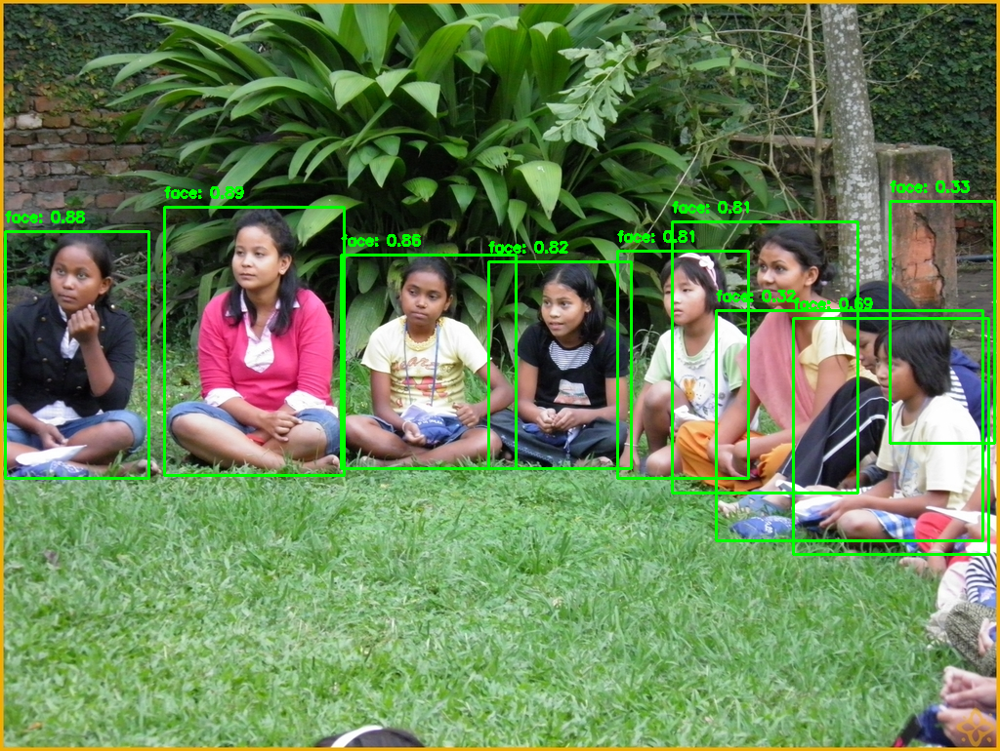

Number of faces detected: 9


In [ ]:
from ultralytics import YOLO
from google.colab.patches import cv2_imshow
import cv2

# Load a pretrained YOLOv5 model. This line downloads the 'yolov5s' model if it's not already cached.
model = YOLO('yolov5s.pt')  # Use 'yolov5s' for a small, fast pretrained model

# Function to predict and display results
def predict_image(image_path):
    # Load the image
    image = cv2.imread(image_path)

    # Perform object detection
    results = model(image_path)  # Run YOLO on the image

    # Counter for detected faces
    face_count = 0

    # Parse results and draw on the image
    for result in results:
        boxes = result.boxes.xyxy.numpy()  # Bounding box coordinates
        confidences = result.boxes.conf.numpy()  # Confidence scores
        class_ids = result.boxes.cls.numpy()  # Class IDs

        for box, conf, class_id in zip(boxes, confidences, class_ids):
            # Check if the detected object is a 'person' (class ID might vary for YOLO configurations)
            if model.names[int(class_id)] =='person':
                face_count += 1  # Increment face count
                x1, y1, x2, y2 = map(int, box)
                label = f"{model.names[int(class_id)]}: {conf:.2f}"
                color = (0, 255, 0)  # Green for bounding boxes
                cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
                cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Show the result using cv2_imshow
    cv2_imshow(image)

    # Print the number of faces detected
    print(f"Number of faces detected: {face_count}")

# Example usage
image_path = "/content/drive/MyDrive/Images/dataset_final/1.jpg"  # Replace with your test image
predict_image(image_path)


In [27]:
!pip install facenet-pytorch


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 25.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 82.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 828.3 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 60.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 50.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 38.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16

In [26]:
from facenet_pytorch import MTCNN
from google.colab.patches import cv2_imshow
import cv2
import torch

# Initialize the MTCNN model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
mtcnn = MTCNN(keep_all=True, device=device)  # MTCNN with support for detecting multiple faces

# Function to predict and display results using MTCNN
def predict_image_mtcnn(image_path):
    # Load the image
    image = cv2.imread(image_path)
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB as MTCNN expects RGB
    face_count = 0

    # Perform face detection
    boxes, confidences = mtcnn.detect(rgb_image, landmarks=False)  # Detect faces

    # If faces are detected, draw bounding boxes
    if boxes is not None:
        for box, conf in zip(boxes, confidences):
            face_count += 1  # Increment face count
            x1, y1, x2, y2 = map(int, box)
            label = f"Conf: {conf:.2f}"
            color = (255, 0, 0)  # Blue for bounding boxes
            cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
            cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Show the result using cv2_imshow
    cv2_imshow(image)
    print(f"Number of faces detected: {face_count}")

# Example usage
image_path = "/content/drive/MyDrive/Images/dataset_final/1.jpg"  # Replace with your test image
predict_image_mtcnn(image_path)


ModuleNotFoundError: No module named 'facenet_pytorch'

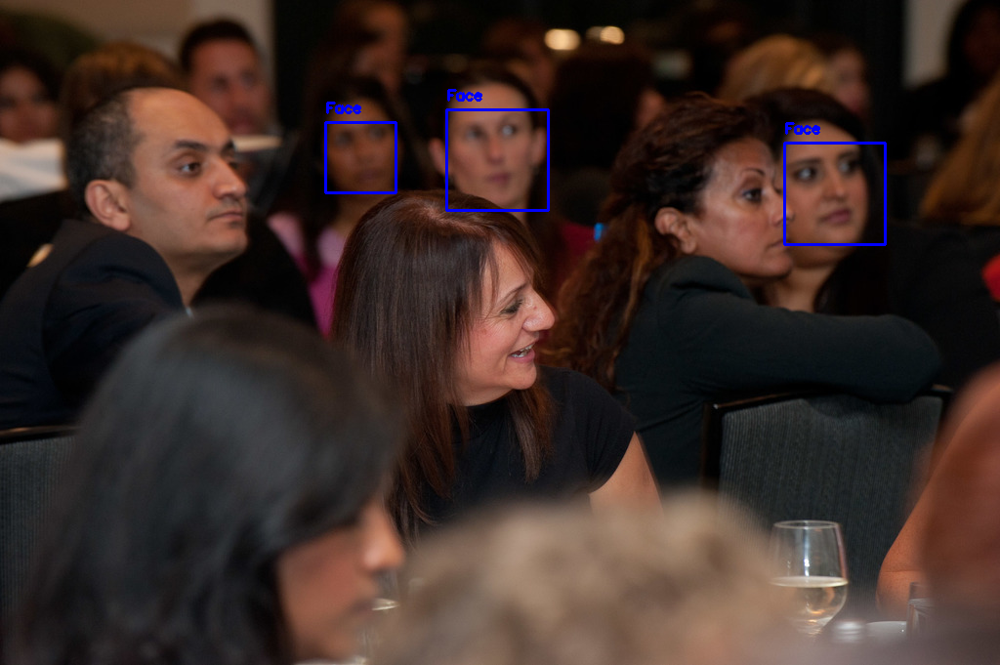

Number of faces detected: 3


In [ ]:
import dlib
import cv2
from google.colab.patches import cv2_imshow

# Load Dlib's pre-trained HOG + SVM face detector
hog_face_detector = dlib.get_frontal_face_detector()

# Function to predict and display faces
def predict_image_hog_face(image_path):
    # Load the image
    image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Convert to grayscale for better detection

    # Detect faces using Dlib's HOG detector
    faces = hog_face_detector(gray_image)
    face_count = 0

    # Draw detections on the image
    for face in faces:
        face_count += 1
        x1, y1, x2, y2 = face.left(), face.top(), face.right(), face.bottom()
        label = "Face"
        color = (255, 0, 0)  # Blue for bounding boxes
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Show the result using cv2_imshow
    cv2_imshow(image)
    print(f"Number of faces detected: {face_count}")
# Example usage
image_path = "/content/drive/MyDrive/Images/dataset_final/6.jpg"  # Replace with your test image
predict_image_hog_face(image_path)


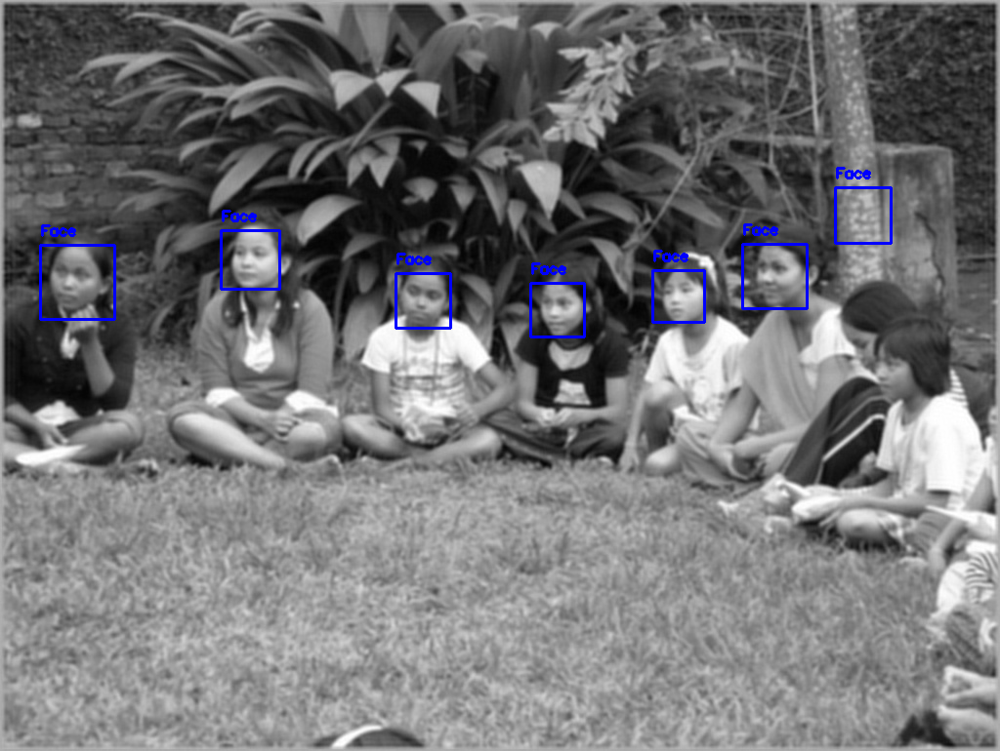

Number of faces detected: 7


In [1]:
from google.colab.patches import cv2_imshow
import cv2

# Load the pre-trained Haar Cascade classifier for face detection
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Function to predict and display results using Viola-Jones (Haar Cascade)
def predict_image_haar(image_path):
    # Load the image
    image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Convert to grayscale as Haar Cascade works on grayscale images

    # Apply Histogram Equalization to improve contrast
    gray_image = cv2.equalizeHist(gray_image)

    face_count = 0

    # Perform face detection with multiple scales
    faces = face_cascade.detectMultiScale(
        gray_image,
        scaleFactor=1.1,  # Slightly higher scale factor to account for larger faces
        minNeighbors=5,   # Minimum neighbors for face detection
        minSize=(30, 30), # Minimum size of detected faces
        flags=cv2.CASCADE_SCALE_IMAGE
    )

    # Draw bounding boxes around detected faces
    for (x, y, w, h) in faces:
        face_count += 1
        color = (255, 0, 0)  # Blue for bounding boxes
        cv2.rectangle(image, (x, y), (x + w, y + h), color, 2)
        cv2.putText(image, "Face", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Show the result using cv2_imshow
    cv2_imshow(image)
    print(f"Number of faces detected: {face_count}")

# Example usage
image_path = "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/noise_variance/noise_0.01/1.jpg"  # Replace with your test image
predict_image_haar(image_path)


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Function to apply Gaussian Blur
def apply_gaussian_blur(image, ksize=7, sigma=1.0):
    """Apply Gaussian Blur with specified kernel size and sigma."""
    if ksize % 2 == 0:  # Ensure kernel size is odd
        ksize += 1
    return cv2.GaussianBlur(image, (ksize, ksize), sigma)

# Function to add Gaussian Noise
def add_gaussian_noise(image, mean=0, std=15):
    """Add Gaussian noise to an image."""
    noise = np.random.normal(mean, std, image.shape).astype(np.uint8)
    noisy_image = cv2.add(image, noise)
    return noisy_image

# Function to adjust contrast and brightness (bad contrast)
def adjust_contrast_brightness(image, alpha=0.5, beta=50):
    """Adjust contrast (alpha) and brightness (beta) of an image."""
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)




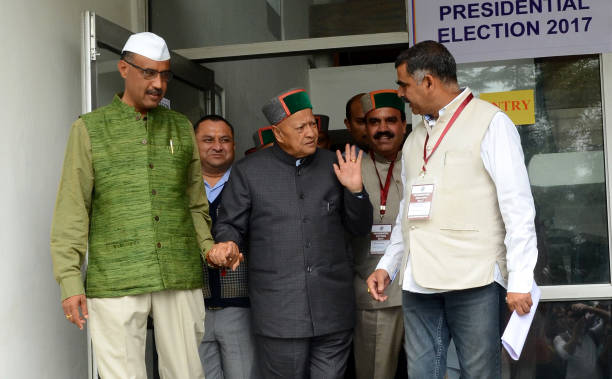

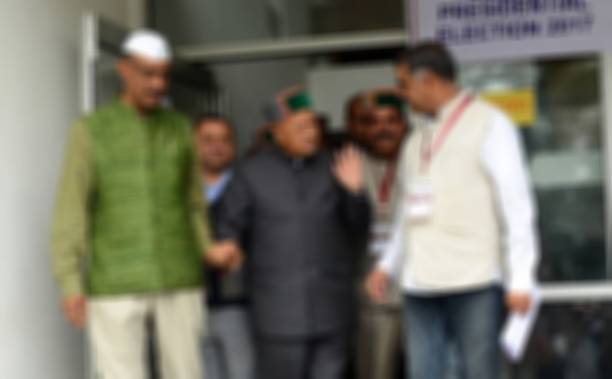

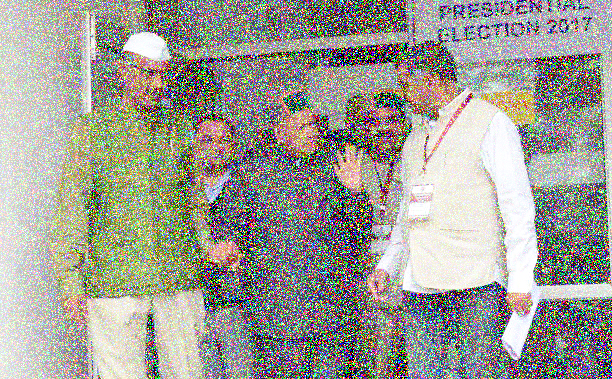

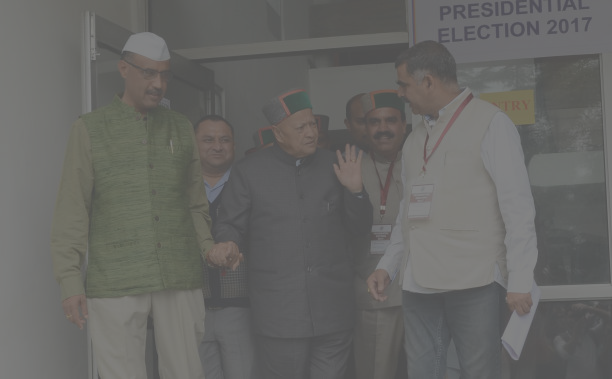

In [ ]:
# Path to your test image
image_path = "/content/drive/MyDrive/Images/dataset_final/7.jpg"  # Replace with your test image
image = cv2.imread(image_path)

# Apply transformations
blurred_image = apply_gaussian_blur(image, ksize=11, sigma=15)  # Adjust kernel size for blur
noisy_image = add_gaussian_noise(image, mean=0, std=2)  # Adjust noise std deviation
low_contrast_image = adjust_contrast_brightness(image, alpha=0.2, beta=80)  # Adjust contrast and brightness

# Show original image
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Show blurred image
cv2_imshow(blurred_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Show noisy image
cv2_imshow(noisy_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Show low contrast image
cv2_imshow(low_contrast_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
import os
input_folder = "/content/drive/MyDrive/Images/dataset_final"  # Replace with your dataset folder path

# Output folder paths
blurred_output_folder = "/content/drive/MyDrive/Images/dataset_blur"
noisy_output_folder = "/content/drive/MyDrive/Images/dataset_noise"
low_contrast_output_folder = "/content/drive/MyDrive/Images/dataset_low_contrast"

# Create output directories if they do not exist
os.makedirs(blurred_output_folder, exist_ok=True)
os.makedirs(noisy_output_folder, exist_ok=True)
os.makedirs(low_contrast_output_folder, exist_ok=True)

# Loop over all images in the input folder
for filename in os.listdir(input_folder):
    # Construct full image path
    image_path = os.path.join(input_folder, filename)

    # Only process image files (filter non-image files if any)
    if image_path.endswith(('.jpg', '.jpeg', '.png', '.bmp')):  # Add more image formats if needed
        # Load the image
        image = cv2.imread(image_path)

        # Apply transformations
        blurred_image = apply_gaussian_blur(image, ksize=11, sigma=2.0)
        noisy_image = add_gaussian_noise(image, mean=0, std=15)
        low_contrast_image = adjust_contrast_brightness(image, alpha=0.2, beta=80)

        # Save the transformed images to the output folders
        blurred_image_path = os.path.join(blurred_output_folder, filename)
        noisy_image_path = os.path.join(noisy_output_folder, filename)
        low_contrast_image_path = os.path.join(low_contrast_output_folder, filename)

        # Save the images
        cv2.imwrite(blurred_image_path, blurred_image)
        cv2.imwrite(noisy_image_path, noisy_image)
        cv2.imwrite(low_contrast_image_path, low_contrast_image)

        print(f"Processed {filename} and saved to output folders.")

print("All images processed and saved.")

Processed 9.jpg and saved to output folders.
Processed 14.jpg and saved to output folders.
Processed 12.jpg and saved to output folders.
Processed 28.jpg and saved to output folders.
Processed 29.jpg and saved to output folders.
Processed 11.jpg and saved to output folders.
Processed 16.jpg and saved to output folders.
Processed 39.jpg and saved to output folders.
Processed 15.jpg and saved to output folders.
Processed 8.jpg and saved to output folders.
Processed 13.jpg and saved to output folders.
Processed 17.jpg and saved to output folders.
Processed 37.jpg and saved to output folders.
Processed 21.jpg and saved to output folders.
Processed 31.jpg and saved to output folders.
Processed 33.jpg and saved to output folders.
Processed 26.jpg and saved to output folders.
Processed 34.jpg and saved to output folders.
Processed 23.jpg and saved to output folders.
Processed 30.jpg and saved to output folders.
Processed 24.jpg and saved to output folders.
Processed 38.jpg and saved to output

In [ ]:
import os
# Path for initial data set and output folder paths
input_folder = "/content/drive/MyDrive/Images/dataset_final"  # Replace with your dataset folder path

# Output folder path for all degraded images
degraded_output_folder = "/content/drive/MyDrive/Images/dataset_degraded_all"

# Create output directory if it doesn't exist
os.makedirs(degraded_output_folder, exist_ok=True)

# Loop over all images in the input folder
for filename in os.listdir(input_folder):
    # Construct full image path
    image_path = os.path.join(input_folder, filename)

    # Only process image files (filter non-image files if any)
    if image_path.endswith(('.jpg', '.jpeg', '.png', '.bmp')):  # Add more image formats if needed
        # Load the image
        image = cv2.imread(image_path)

        # Apply transformations
        blurred_image = apply_gaussian_blur(image, ksize=11, sigma=2)  # Example blur
        noisy_image = add_gaussian_noise(image, std=15)  # Example noise
        low_contrast_image = adjust_contrast_brightness(image, alpha=0.3, beta=80)  # Example low contrast

        # Combine the effects (blur + noise + low contrast)
        degraded_image = cv2.addWeighted(blurred_image, 0.5, noisy_image, 0.5, 0)
        degraded_image = cv2.addWeighted(degraded_image, 0.5, low_contrast_image, 0.5, 0)

        # Save the degraded image to the output folder
        degraded_image_path = os.path.join(degraded_output_folder, filename)
        cv2.imwrite(degraded_image_path, degraded_image)

        print(f"Processed {filename} and saved to output folder.")

print("All images processed and saved.")

Processed 9.jpg and saved to output folder.
Processed 14.jpg and saved to output folder.
Processed 12.jpg and saved to output folder.
Processed 28.jpg and saved to output folder.
Processed 29.jpg and saved to output folder.
Processed 11.jpg and saved to output folder.
Processed 16.jpg and saved to output folder.
Processed 39.jpg and saved to output folder.
Processed 15.jpg and saved to output folder.
Processed 8.jpg and saved to output folder.
Processed 13.jpg and saved to output folder.
Processed 17.jpg and saved to output folder.
Processed 37.jpg and saved to output folder.
Processed 21.jpg and saved to output folder.
Processed 31.jpg and saved to output folder.
Processed 33.jpg and saved to output folder.
Processed 26.jpg and saved to output folder.
Processed 34.jpg and saved to output folder.
Processed 23.jpg and saved to output folder.
Processed 30.jpg and saved to output folder.
Processed 24.jpg and saved to output folder.
Processed 38.jpg and saved to output folder.
Processed 27

In [16]:
!pip install bm3d


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 862.0/862.0 kB 12.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 55.6 MB/s eta 0:00:00


In [11]:
import cv2
import numpy as np
from skimage.restoration import denoise_tv_chambolle, unsupervised_wiener
from bm3d import bm3d
from sklearn.decomposition import DictionaryLearning




# Function for Wiener Deconvolution
def wiener_deconvolution(image, noise_var=0.01, kernel_size=5):
    """Apply Wiener Deconvolution to deblur the image."""
    # Create a simple Gaussian kernel (PSF) with a given size
    kernel = np.ones((kernel_size, kernel_size)) / (kernel_size ** 2)  # Simple average filter as kernel

    # Apply Wiener filter (skimage.wiener expects an image and noise variance)
    deblurred_image = wiener(image, kernel, noise_var)

    # Scale back to uint8 and clip to valid range [0, 255]
    deblurred_image = np.clip(deblurred_image * 255, 0, 255).astype(np.uint8)
    return deblurred_image

# Function for Blind Deconvolution
def blind_deconvolution(image, kernel_size=5):
    """Apply Blind Deconvolution."""
    psf = np.ones((kernel_size, kernel_size)) / (kernel_size**2)  # Initial PSF
    deconvolved, _ = unsupervised_wiener(image, psf)
    deconvolved = np.clip(deconvolved * 255, 0, 255).astype(np.uint8)  # Ensure values are within [0, 255]
    return deconvolved

# Function for Gaussian Blur Denoising
def apply_gaussian_blur(image, kernel_size, sigma):
    """Apply Gaussian Blur to the image."""
    denoised_image = cv2.GaussianBlur(image, kernel_size, sigma)
    return denoised_image

# Function for TV Denoising
def apply_tv_denoising(image, weight):
    """Apply Total Variation Denoising to the image."""
    denoised_image = denoise_tv_chambolle(image / 255.0, weight=weight)  # Normalize image to [0, 1]
    return (denoised_image * 255).astype(np.uint8)  # Convert back to uint8


# Contrast Enhancement using CLAHE
def apply_clahe(image):
    """Apply CLAHE (Contrast Limited Adaptive Histogram Equalization)."""
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)  # Convert to LAB color space
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l_clahe = clahe.apply(l)
    lab_clahe = cv2.merge((l_clahe, a, b))
    enhanced_image = cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2BGR)
    return enhanced_image

In [12]:
import os
import cv2
import numpy as np
from skimage.restoration import unsupervised_wiener, wiener
from google.colab.patches import cv2_imshow

# Folder paths
blurred_image_folder = "/content/drive/MyDrive/Images/dataset_blur"  # Folder with blurred images
output_folder = "/content/drive/MyDrive/Images/deblurred_images"  # Folder to save deblurred images

# Create necessary directories for storing output images
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Subfolders for Wiener Deconvolution and Blind Deconvolution
wiener_folder = os.path.join(output_folder, 'wiener_deconvolution')
blind_folder = os.path.join(output_folder, 'blind_deconvolution')

if not os.path.exists(wiener_folder):
    os.makedirs(wiener_folder)
if not os.path.exists(blind_folder):
    os.makedirs(blind_folder)

# Subfolders for Wiener Deconvolution variations (noise variance and kernel variation)
wiener_noise_var_folder = os.path.join(wiener_folder, 'noise_variance')
wiener_kernel_var_folder = os.path.join(wiener_folder, 'kernel_variation')

if not os.path.exists(wiener_noise_var_folder):
    os.makedirs(wiener_noise_var_folder)
if not os.path.exists(wiener_kernel_var_folder):
    os.makedirs(wiener_kernel_var_folder)

# Subfolders for Blind Deconvolution kernel sizes (3, 5, 7)
blind_kernel_sizes = [3, 5, 7]
blind_subfolders = {}

# Create subfolders for Blind Deconvolution based on kernel sizes
for kernel_size in blind_kernel_sizes:
    kernel_folder = os.path.join(blind_folder, f"kernel_{kernel_size}")
    if not os.path.exists(kernel_folder):
        os.makedirs(kernel_folder)
    blind_subfolders[kernel_size] = kernel_folder



# Get all blurred images
blurred_images = [f for f in os.listdir(blurred_image_folder) if f.endswith('.jpg')]

# Loop through each image in the blurred folder and apply deblurring methods
for image_name in blurred_images:
    image_path = os.path.join(blurred_image_folder, image_name)
    blurred_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    if blurred_image is None:
        print(f"Error loading image {image_name}. Skipping.")
        continue

    # Normalize the image
    normalized_image = blurred_image / 255.0

    # Create subfolders for Wiener Deconvolution noise variance variations (0.01, 0.05)
    for noise_var in [0.01, 0.05]:
        noise_folder = os.path.join(wiener_noise_var_folder, f"noise_{noise_var}")
        if not os.path.exists(noise_folder):
            os.makedirs(noise_folder)

        # Apply Wiener Deconvolution with the given noise variance
        deblurred_wiener = wiener_deconvolution(normalized_image, noise_var=noise_var, kernel_size=5)
        output_wiener_path = os.path.join(noise_folder, f"{os.path.splitext(image_name)[0]}.jpg")
        cv2.imwrite(output_wiener_path, deblurred_wiener)

    # Create subfolders for Wiener Deconvolution kernel size variations (3, 5, 7)
    for kernel_size in [3, 5, 7]:
        kernel_folder = os.path.join(wiener_kernel_var_folder, f"kernel_{kernel_size}")
        if not os.path.exists(kernel_folder):
            os.makedirs(kernel_folder)

        # Apply Wiener Deconvolution with the given kernel size
        deblurred_wiener_kernel = wiener_deconvolution(normalized_image, noise_var=0.01, kernel_size=kernel_size)
        output_wiener_kernel_path = os.path.join(kernel_folder, f"{os.path.splitext(image_name)[0]}.jpg")
        cv2.imwrite(output_wiener_kernel_path, deblurred_wiener_kernel)

    # Apply Blind Deconvolution with different kernel sizes (3, 5, 7)
    for kernel_size in blind_kernel_sizes:
        deblurred_blind = blind_deconvolution(normalized_image, kernel_size=kernel_size)
        output_blind_path = os.path.join(blind_subfolders[kernel_size], f"{os.path.splitext(image_name)[0]}.jpg")
        cv2.imwrite(output_blind_path, deblurred_blind)

print("Deblurring completed. Output images saved in respective subfolders.")


Deblurring completed. Output images saved in respective subfolders.


In [13]:
!pip install ksvd


In [17]:
import os
import cv2
import numpy as np
from skimage.restoration import denoise_tv_chambolle
from skimage.util import img_as_ubyte

# Folder paths
noise_image_folder = "/content/drive/MyDrive/Images/dataset_noise"  # Folder with noisy images
output_folder = "/content/drive/MyDrive/Images/denoised_images"  # Folder to save denoised images

# Create necessary directories for storing output images
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Subfolders for Gaussian Blur and TV Denoising
gaussian_folder = os.path.join(output_folder, 'gaussian_variations')
tv_folder = os.path.join(output_folder, 'tv_variations')

if not os.path.exists(gaussian_folder):
    os.makedirs(gaussian_folder)
if not os.path.exists(tv_folder):
    os.makedirs(tv_folder)

# Create subdirectories for Sigma Variations in Gaussian Blur (kernel size fixed to 9x9)
gaussian_sigma_1_5 = os.path.join(gaussian_folder, 'sigma_1_5')
gaussian_sigma_2 = os.path.join(gaussian_folder, 'sigma_2')
gaussian_sigma_2_5 = os.path.join(gaussian_folder, 'sigma_2_5')

# Create subdirectories for Kernel Variations in Gaussian Blur (sigma fixed to 2)
gaussian_kernel_7x7 = os.path.join(gaussian_folder, 'kernel_7x7')
gaussian_kernel_9x9 = os.path.join(gaussian_folder, 'kernel_9x9')
gaussian_kernel_11x11 = os.path.join(gaussian_folder, 'kernel_11x11')

# Create subdirectories for each TV variation
tv_weight_02 = os.path.join(tv_folder, 'weight_02')
tv_weight_05 = os.path.join(tv_folder, 'weight_05')
tv_weight_08 = os.path.join(tv_folder, 'weight_08')

# Create all necessary subdirectories if they don't exist
os.makedirs(gaussian_sigma_1_5, exist_ok=True)
os.makedirs(gaussian_sigma_2, exist_ok=True)
os.makedirs(gaussian_sigma_2_5, exist_ok=True)

os.makedirs(gaussian_kernel_7x7, exist_ok=True)
os.makedirs(gaussian_kernel_9x9, exist_ok=True)
os.makedirs(gaussian_kernel_11x11, exist_ok=True)

os.makedirs(tv_weight_02, exist_ok=True)
os.makedirs(tv_weight_05, exist_ok=True)
os.makedirs(tv_weight_08, exist_ok=True)

# Function for Gaussian Blur Denoising
def apply_gaussian_blur(image, kernel_size, sigma):
    """Apply Gaussian Blur to the image."""
    denoised_image = cv2.GaussianBlur(image, kernel_size, sigma)
    return denoised_image

# Function for TV Denoising
def apply_tv_denoising(image, weight):
    """Apply Total Variation Denoising to the image."""
    denoised_image = denoise_tv_chambolle(image / 255.0, weight=weight)  # Normalize image to [0, 1]
    return (denoised_image * 255).astype(np.uint8)  # Convert back to uint8

# Get all noisy images
noisy_images = [f for f in os.listdir(noise_image_folder) if f.endswith('.jpg')]

# Loop through each image in the noisy folder and apply denoising methods
for image_name in noisy_images:
    image_path = os.path.join(noise_image_folder, image_name)
    noisy_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    if noisy_image is None:
        print(f"Error loading image {image_name}. Skipping.")
        continue

    # Apply Gaussian Blur with varying sigma values, kernel size fixed to 9x9
    sigma_values = [1.5, 2, 2.5]
    kernel_size = (9, 9)

    # Save based on Sigma variations
    for sigma in sigma_values:
        if sigma == 1.5:
            output_folder_gaussian = gaussian_sigma_1_5
        elif sigma == 2:
            output_folder_gaussian = gaussian_sigma_2
        else:
            output_folder_gaussian = gaussian_sigma_2_5

        denoised_gaussian = apply_gaussian_blur(noisy_image, kernel_size, sigma)
        output_gaussian = os.path.join(output_folder_gaussian, f"{os.path.splitext(image_name)[0]}.jpg")
        cv2.imwrite(output_gaussian, denoised_gaussian)

    # Apply Gaussian Blur with sigma fixed to 2, varying kernel sizes
    sigma = 2
    kernel_sizes = [(7, 7), (9, 9), (11, 11)]

    # Save based on Kernel variations (only for sigma = 2)
    for kernel_size in kernel_sizes:
        if kernel_size == (7, 7):
            output_folder_kernel = gaussian_kernel_7x7
        elif kernel_size == (9, 9):
            output_folder_kernel = gaussian_kernel_9x9
        else:
            output_folder_kernel = gaussian_kernel_11x11

        denoised_gaussian = apply_gaussian_blur(noisy_image, kernel_size, sigma)
        output_gaussian = os.path.join(output_folder_kernel, f"{os.path.splitext(image_name)[0]}.jpg")
        cv2.imwrite(output_gaussian, denoised_gaussian)

    # Apply TV Denoising with varying weight values
    weight_values = [0.2, 0.5, 0.8]
    for weight in weight_values:
        if weight == 0.2:
            output_folder_tv = tv_weight_02
        elif weight == 0.5:
            output_folder_tv = tv_weight_05
        else:
            output_folder_tv = tv_weight_08

        denoised_tv = apply_tv_denoising(noisy_image, weight)
        output_tv = os.path.join(output_folder_tv, f"{os.path.splitext(image_name)[0]}.jpg")
        cv2.imwrite(output_tv, denoised_tv)

print("Denoising completed. Output images saved in respective subfolders.")


Denoising completed. Output images saved in respective subfolders.


In [63]:
import os
import cv2
import numpy as np

# Folder paths
input_folder = "/content/drive/MyDrive/Images/dataset_low_contrast"  # Folder with low contrast images
output_folder = "/content/drive/MyDrive/Images/contrast_enhanced_images"  # Folder to save the CLAHE enhanced images

# Create necessary directories for storing output images
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Create subfolders for clip limit variations
clip_limit_folder = os.path.join(output_folder, 'clipLimit_variations')
if not os.path.exists(clip_limit_folder):
    os.makedirs(clip_limit_folder)

clip_limit_2_folder = os.path.join(clip_limit_folder, 'clipLimit_2')
clip_limit_4_folder = os.path.join(clip_limit_folder, 'clipLimit_4')
clip_limit_6_folder = os.path.join(clip_limit_folder, 'clipLimit_6')
os.makedirs(clip_limit_2_folder, exist_ok=True)
os.makedirs(clip_limit_4_folder, exist_ok=True)
os.makedirs(clip_limit_6_folder, exist_ok=True)

# Create subfolders for tile size variations
tile_size_folder = os.path.join(output_folder, 'tileSize_variations')
if not os.path.exists(tile_size_folder):
    os.makedirs(tile_size_folder)

tile_size_8x8_folder = os.path.join(tile_size_folder, 'tileSize_8x8')
tile_size_10x10_folder = os.path.join(tile_size_folder, 'tileSize_10x10')
os.makedirs(tile_size_8x8_folder, exist_ok=True)
os.makedirs(tile_size_10x10_folder, exist_ok=True)

# Function for CLAHE enhancement
def apply_clahe(image, clip_limit=2.0, tile_grid_size=(8, 8)):
    """Apply CLAHE to enhance the contrast of the image."""
    if len(image.shape) == 3:  # Convert to grayscale if image is in color
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    clahe_image = clahe.apply(image)
    return clahe_image

# Get all low contrast images
low_contrast_images = [f for f in os.listdir(input_folder) if f.endswith('.jpg')]

# Loop through each image in the low contrast folder and apply CLAHE
for image_name in low_contrast_images:
    image_path = os.path.join(input_folder, image_name)
    low_contrast_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    if low_contrast_image is None:
        print(f"Error loading image {image_name}. Skipping.")
        continue

    # Apply Clip Limit variations
    for clip_limit in [2, 4, 6]:
        # Apply CLAHE with the current clip limit and tileGridSize = (8, 8)
        enhanced_image = apply_clahe(low_contrast_image, clip_limit=clip_limit, tile_grid_size=(8, 8))

        # Save the enhanced image in the respective folder
        output_path = os.path.join(clip_limit_folder, f'clipLimit_{clip_limit}', f"{os.path.splitext(image_name)[0]}.jpg")
        cv2.imwrite(output_path, enhanced_image)

    # Apply Tile Size variations (keeping clipLimit=2)
    for tile_size in [(8, 8), (10, 10)]:
        # Apply CLAHE with the current tile size and clipLimit=2
        enhanced_image = apply_clahe(low_contrast_image, clip_limit=2, tile_grid_size=tile_size)

        # Save the enhanced image in the respective folder
        output_path = os.path.join(tile_size_folder, f'tileSize_{tile_size[0]}x{tile_size[1]}', f"{os.path.splitext(image_name)[0]}.jpg")
        cv2.imwrite(output_path, enhanced_image)

print("CLAHE enhancement completed. Output images saved in respective subfolders.")


CLAHE enhancement completed. Output images saved in respective subfolders.


In [6]:
original = df
original

,image_name,num_faces
0,1.jpg,9
1,2.jpg,14
2,3.jpg,8
3,4.jpg,6
4,5.jpg,6
5,6.jpg,18
6,7.jpg,6
7,8.jpg,11
8,9.jpg,8
9,10.jpg,9


In [16]:
import os
import cv2
import pandas as pd
from tqdm import tqdm

# Load Haar Cascade
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Function for face detection using Haar Cascade
def detect_faces(image_path):
    image = cv2.imread(image_path)
    if image is None:  # Debugging: Check if the image is loaded correctly
        print(f"Failed to load image: {image_path}")
        return 0
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(
        gray_image,
        scaleFactor=1.1,
        minNeighbors=5,
        minSize=(30, 30),
        flags=cv2.CASCADE_SCALE_IMAGE
    )
    return len(faces)

# Paths to datasets
original_dataset = "/content/drive/MyDrive/Images/dataset_final"
blurred_dataset = "/content/drive/MyDrive/Images/dataset_blur"
deblurred_blindconv_datasets = {
    "kernel3": "/content/drive/MyDrive/Images/deblurred_images/blind_deconvolution/kernel_3",
    "kernel5": "/content/drive/MyDrive/Images/deblurred_images/blind_deconvolution/kernel_5",
    "kernel7": "/content/drive/MyDrive/Images/deblurred_images/blind_deconvolution/kernel_7"
}
deblurred_wiener_kernel_datasets = {
    "kernel3": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/kernel_variation/kernel_3",
    "kernel5": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/kernel_variation/kernel_5",
    "kernel7": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/kernel_variation/kernel_7"
}
deblurred_wiener_noise_datasets = {
    "noise_0.01": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/noise_variance/noise_0.01",
    "noise_0.05": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/noise_variance/noise_0.05"
}

# Load the dataframe with actual face counts
df = original # Ensure this has 'image_name' and 'actual_faces' columns

# Initialize results dataframe
haarcascade_blur_results = df.copy()
haarcascade_blur_results['faces_detected_in_blurred'] = 0

# Add columns for deblurred images
for kernel in deblurred_blindconv_datasets:
    haarcascade_blur_results[f'faces_blindconv_{kernel}'] = 0

for kernel in deblurred_wiener_kernel_datasets:
    haarcascade_blur_results[f'faces_wiener_{kernel}'] = 0

for noise_var in deblurred_wiener_noise_datasets:
    haarcascade_blur_results[f'faces_wiener_{noise_var}'] = 0

# Match original dataset to ensure all images are processed
print("Matching original dataset...")
original_images = set(os.listdir(original_dataset))
haarcascade_blur_results = haarcascade_blur_results[haarcascade_blur_results['image_name'].isin(original_images)]

# Process blurred images
print("Processing blurred images...")
for idx, row in tqdm(haarcascade_blur_results.iterrows(), total=len(haarcascade_blur_results)):
    image_path = os.path.join(blurred_dataset, row['image_name'])
    if os.path.exists(image_path):
        haarcascade_blur_results.loc[idx, 'faces_detected_in_blurred'] = detect_faces(image_path)

# Process deblurred images (Blind Convolution)
print("Processing deblurred images (Blind Convolution)...")
for kernel, dataset_path in deblurred_blindconv_datasets.items():
    for idx, row in tqdm(haarcascade_blur_results.iterrows(), total=len(haarcascade_blur_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            haarcascade_blur_results.loc[idx, f'faces_blindconv_{kernel}'] = detect_faces(image_path)

# Process deblurred images (Wiener - Kernel Variations)
print("Processing deblurred images (Wiener - Kernel Variations)...")
for kernel, dataset_path in deblurred_wiener_kernel_datasets.items():
    for idx, row in tqdm(haarcascade_blur_results.iterrows(), total=len(haarcascade_blur_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            haarcascade_blur_results.loc[idx, f'faces_wiener_{kernel}'] = detect_faces(image_path)

# Process deblurred images (Wiener - Noise Variations)
print("Processing deblurred images (Wiener - Noise Variations)...")
for noise_var, dataset_path in deblurred_wiener_noise_datasets.items():
    for idx, row in tqdm(haarcascade_blur_results.iterrows(), total=len(haarcascade_blur_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            haarcascade_blur_results.loc[idx, f'faces_wiener_{noise_var}'] = detect_faces(image_path)
        else:
            print(f"Image not found for noise variation {noise_var}: {row['image_name']}")

# Save final dataframe to CSV
output_path = '/content/drive/MyDrive/Images/output_files/haar_cascade_blur.csv'
haarcascade_blur_results.to_csv(output_path, index=False)
print(f"Results saved to {output_path}")


Matching original dataset...
Processing blurred images...


100%|██████████| 40/40 [00:22<00:00,  1.78it/s]


Processing deblurred images (Blind Convolution)...


100%|██████████| 40/40 [00:30<00:00,  1.33it/s]


Processing deblurred images (Wiener - Kernel Variations)...


100%|██████████| 40/40 [00:24<00:00,  1.60it/s]


Processing deblurred images (Wiener - Noise Variations)...


100%|██████████| 40/40 [00:22<00:00,  1.79it/s]

Results saved to /content/drive/MyDrive/Images/output_files/haar_cascade_blur.csv


In [18]:


# Paths to datasets
noisy_dataset = "/content/drive/MyDrive/Images/dataset_noise"
denoised_gaussian_datasets = {
    "kernel_7": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/kernel_7x7",
    "kernel_9": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/kernel_9x9",
    "kernel_11": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/kernel_11x11",
    "sigma_1.5": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/sigma_1_5",
    "sigma_2": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/sigma_2",
    "sigma_2.5": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/sigma_2_5"
}
denoised_tv_datasets = {
    "weight_0.2": "/content/drive/MyDrive/Images/denoised_images/tv_variations/weight_02",
    "weight_0.5": "/content/drive/MyDrive/Images/denoised_images/tv_variations/weight_05",
    "weight_0.8": "/content/drive/MyDrive/Images/denoised_images/tv_variations/weight_08"
}

# Load the dataframe with actual face counts
df = original  # Ensure this has 'image_name' and 'actual_faces' columns

# Initialize results dataframe
haarcascade_denoising_results = df.copy()
haarcascade_denoising_results['faces_detected_in_noisy'] = 0

# Add columns for denoised images
for variation in denoised_gaussian_datasets:
    haarcascade_denoising_results[f'gaussian_{variation}'] = 0

for variation in denoised_tv_datasets:
    haarcascade_denoising_results[f'tv_{variation}'] = 0

# Match noisy dataset to ensure all images are processed
print("Matching noisy dataset...")
noisy_images = set(os.listdir(noisy_dataset))
haarcascade_denoising_results = haarcascade_denoising_results[haarcascade_denoising_results['image_name'].isin(noisy_images)]

# Process noisy images
print("Processing noisy images...")
for idx, row in tqdm(haarcascade_denoising_results.iterrows(), total=len(haarcascade_denoising_results)):
    image_path = os.path.join(noisy_dataset, row['image_name'])
    if os.path.exists(image_path):
        haarcascade_denoising_results.loc[idx, 'faces_detected_in_noisy'] = detect_faces(image_path)

# Process denoised images (Gaussian Variations)
print("Processing denoised images (Gaussian Variations)...")
for variation, dataset_path in denoised_gaussian_datasets.items():
    for idx, row in tqdm(haarcascade_denoising_results.iterrows(), total=len(haarcascade_denoising_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            haarcascade_denoising_results.loc[idx, f'gaussian_{variation}'] = detect_faces(image_path)

# Process denoised images (Total Variation Variations)
print("Processing denoised images (TV Variations)...")
for variation, dataset_path in denoised_tv_datasets.items():
    for idx, row in tqdm(haarcascade_denoising_results.iterrows(), total=len(haarcascade_denoising_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            haarcascade_denoising_results.loc[idx, f'tv_{variation}'] = detect_faces(image_path)

# Save final dataframe to CSV
output_path = "/content/drive/MyDrive/Images/output_files/haarcascade_denoising_results.csv"
haarcascade_denoising_results.to_csv(output_path, index=False)
print(f"Results saved to {output_path}")


Matching noisy dataset...
Processing noisy images...


100%|██████████| 40/40 [00:34<00:00,  1.14it/s]


Processing denoised images (Gaussian Variations)...


100%|██████████| 40/40 [00:27<00:00,  1.44it/s]


Processing denoised images (TV Variations)...


100%|██████████| 40/40 [00:18<00:00,  2.21it/s]

Results saved to /content/drive/MyDrive/Images/output_files/haarcascade_denoising_results.csv


In [15]:


# Paths to datasets
original_dataset = "/content/drive/MyDrive/Images/dataset_final"
low_contrast_dataset = "/content/drive/MyDrive/Images/dataset_low_contrast"
contrast_enhanced_images = "/content/drive/MyDrive/Images/contrast_enhanced_images"
cliplimit_variations = {
    "cliplimit_2": "/content/drive/MyDrive/Images/contrast_enhanced_images/clipLimit_variations/clipLimit_2",
    "cliplimit_4": "/content/drive/MyDrive/Images/contrast_enhanced_images/clipLimit_variations/clipLimit_4",
    "cliplimit_6": "/content/drive/MyDrive/Images/contrast_enhanced_images/clipLimit_variations/clipLimit_6"
}
tilesize_variations = {
    "tilesize_8": "/content/drive/MyDrive/Images/contrast_enhanced_images/tileSize_variations/tileSize_8x8",
    "tilesize_10": "/content/drive/MyDrive/Images/contrast_enhanced_images/tileSize_variations/tileSize_10x10"
}

# Load the dataframe with actual face counts
df = original  # Ensure this has 'image_name' and 'actual_faces' columns

# Initialize results dataframe
haarcascade_contrast_results = df.copy()
haarcascade_contrast_results['faces_detected_in_badcontrast'] = 0

# Add columns for contrast-enhanced images
for clip in cliplimit_variations:
    haarcascade_contrast_results[f'faces_cliplimit_{clip}'] = 0

for tilesize in tilesize_variations:
    haarcascade_contrast_results[f'faces_tilesize_{tilesize}'] = 0

# Match original dataset to ensure all images are processed
print("Matching original dataset...")
original_images = set(os.listdir(original_dataset))
haarcascade_contrast_results = haarcascade_contrast_results[haarcascade_contrast_results['image_name'].isin(original_images)]

# Process low contrast images
print("Processing low contrast images...")
for idx, row in tqdm(haarcascade_contrast_results.iterrows(), total=len(haarcascade_contrast_results)):
    image_path = os.path.join(low_contrast_dataset, row['image_name'])
    if os.path.exists(image_path):
        haarcascade_contrast_results.loc[idx, 'faces_detected_in_badcontrast'] = detect_faces(image_path)

# Process contrast-enhanced images (Cliplimit Variations)
print("Processing contrast-enhanced images (Cliplimit Variations)...")
for clip, dataset_path in cliplimit_variations.items():
    for idx, row in tqdm(haarcascade_contrast_results.iterrows(), total=len(haarcascade_contrast_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            haarcascade_contrast_results.loc[idx, f'faces_cliplimit_{clip}'] = detect_faces(image_path)

# Process contrast-enhanced images (Tilesize Variations)
print("Processing contrast-enhanced images (Tilesize Variations)...")
for tilesize, dataset_path in tilesize_variations.items():
    for idx, row in tqdm(haarcascade_contrast_results.iterrows(), total=len(haarcascade_contrast_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            haarcascade_contrast_results.loc[idx, f'faces_tilesize_{tilesize}'] = detect_faces(image_path)

# Save final dataframe to CSV
output_path = '/content/drive/MyDrive/Images/output_files/haar_cascade_contrast_enhanced.csv'
haarcascade_contrast_results.to_csv(output_path, index=False)
print(f"Results saved to {output_path}")


Matching original dataset...
Processing low contrast images...


100%|██████████| 40/40 [00:17<00:00,  2.24it/s]


Processing contrast-enhanced images (Cliplimit Variations)...


100%|██████████| 40/40 [00:35<00:00,  1.12it/s]


Processing contrast-enhanced images (Tilesize Variations)...


100%|██████████| 40/40 [00:30<00:00,  1.29it/s]

Results saved to /content/drive/MyDrive/Images/output_files/haar_cascade_contrast_enhanced.csv


In [19]:
import os
import cv2
import pandas as pd
from tqdm import tqdm
from facenet_pytorch import MTCNN
import torch

# Initialize the MTCNN model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
mtcnn = MTCNN(keep_all=True, device=device)  # MTCNN with support for detecting multiple faces

# Function to predict number of faces using MTCNN
def detect_faces_mtcnn(image_path):
    image = cv2.imread(image_path)
    if image is None:  # Debugging: Check if the image is loaded correctly
        print(f"Failed to load image: {image_path}")
        return 0
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB as MTCNN expects RGB
    boxes, confidences = mtcnn.detect(rgb_image, landmarks=False)  # Detect faces
    return len(boxes) if boxes is not None else 0

# Paths to datasets (same as for Haar Cascade)
original_dataset = "/content/drive/MyDrive/Images/dataset_final"
low_contrast_dataset = "/content/drive/MyDrive/Images/dataset_low_contrast"
contrast_enhanced_images = "/content/drive/MyDrive/Images/contrast_enhanced_images"
cliplimit_variations = {
    "cliplimit_2": "/content/drive/MyDrive/Images/contrast_enhanced_images/clipLimit_variations/clipLimit_2",
    "cliplimit_4": "/content/drive/MyDrive/Images/contrast_enhanced_images/clipLimit_variations/clipLimit_4",
    "cliplimit_6": "/content/drive/MyDrive/Images/contrast_enhanced_images/clipLimit_variations/clipLimit_6"
}
tilesize_variations = {
    "tilesize_8": "/content/drive/MyDrive/Images/contrast_enhanced_images/tileSize_variations/tileSize_8x8",
    "tilesize_10": "/content/drive/MyDrive/Images/contrast_enhanced_images/tileSize_variations/tileSize_10x10"
}

# Load the dataframe with actual face counts (ensure it has 'image_name' and 'actual_faces' columns)
df = original  # Assuming you have the original dataframe loaded here

# Initialize results dataframe
mtcnn_contrast_results = df.copy()
mtcnn_contrast_results['faces_detected_in_badcontrast'] = 0

# Add columns for contrast-enhanced images
for clip in cliplimit_variations:
    mtcnn_contrast_results[f'faces_cliplimit_{clip}'] = 0

for tilesize in tilesize_variations:
    mtcnn_contrast_results[f'faces_tilesize_{tilesize}'] = 0

# Match original dataset to ensure all images are processed
print("Matching original dataset...")
original_images = set(os.listdir(original_dataset))
mtcnn_contrast_results = mtcnn_contrast_results[mtcnn_contrast_results['image_name'].isin(original_images)]

# Process low contrast images
print("Processing low contrast images...")
for idx, row in tqdm(mtcnn_contrast_results.iterrows(), total=len(mtcnn_contrast_results)):
    image_path = os.path.join(low_contrast_dataset, row['image_name'])
    if os.path.exists(image_path):
        mtcnn_contrast_results.loc[idx, 'faces_detected_in_badcontrast'] = detect_faces_mtcnn(image_path)

# Process contrast-enhanced images (Cliplimit Variations)
print("Processing contrast-enhanced images (Cliplimit Variations)...")
for clip, dataset_path in cliplimit_variations.items():
    for idx, row in tqdm(mtcnn_contrast_results.iterrows(), total=len(mtcnn_contrast_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            mtcnn_contrast_results.loc[idx, f'faces_cliplimit_{clip}'] = detect_faces_mtcnn(image_path)

# Process contrast-enhanced images (Tilesize Variations)
print("Processing contrast-enhanced images (Tilesize Variations)...")
for tilesize, dataset_path in tilesize_variations.items():
    for idx, row in tqdm(mtcnn_contrast_results.iterrows(), total=len(mtcnn_contrast_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            mtcnn_contrast_results.loc[idx, f'faces_tilesize_{tilesize}'] = detect_faces_mtcnn(image_path)

# Save final dataframe to CSV
output_path = '/content/drive/MyDrive/Images/output_files/mtcnn_contrast_enhanced.csv'
mtcnn_contrast_results.to_csv(output_path, index=False)
print(f"Results saved to {output_path}")


Matching original dataset...
Processing low contrast images...


100%|██████████| 40/40 [00:12<00:00,  3.08it/s]


Processing contrast-enhanced images (Cliplimit Variations)...


100%|██████████| 40/40 [00:19<00:00,  2.01it/s]


Processing contrast-enhanced images (Tilesize Variations)...


100%|██████████| 40/40 [00:14<00:00,  2.67it/s]

Results saved to /content/drive/MyDrive/Images/output_files/mtcnn_contrast_enhanced.csv


In [20]:
# Paths to datasets
original_dataset = "/content/drive/MyDrive/Images/dataset_final"
blurred_dataset = "/content/drive/MyDrive/Images/dataset_blur"
deblurred_blindconv_datasets = {
    "kernel3": "/content/drive/MyDrive/Images/deblurred_images/blind_deconvolution/kernel_3",
    "kernel5": "/content/drive/MyDrive/Images/deblurred_images/blind_deconvolution/kernel_5",
    "kernel7": "/content/drive/MyDrive/Images/deblurred_images/blind_deconvolution/kernel_7"
}
deblurred_wiener_kernel_datasets = {
    "kernel3": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/kernel_variation/kernel_3",
    "kernel5": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/kernel_variation/kernel_5",
    "kernel7": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/kernel_variation/kernel_7"
}
deblurred_wiener_noise_datasets = {
    "noise_0.01": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/noise_variance/noise_0.01",
    "noise_0.05": "/content/drive/MyDrive/Images/deblurred_images/wiener_deconvolution/noise_variance/noise_0.05"
}

# Load the dataframe with actual face counts
df = original  # Ensure this has 'image_name' and 'actual_faces' columns

# Initialize results dataframe
mtcnn_blur_results = df.copy()
mtcnn_blur_results['faces_detected_in_blurred'] = 0

# Add columns for deblurred images
for kernel in deblurred_blindconv_datasets:
    mtcnn_blur_results[f'faces_blindconv_{kernel}'] = 0

for kernel in deblurred_wiener_kernel_datasets:
    mtcnn_blur_results[f'faces_wiener_{kernel}'] = 0

for noise_var in deblurred_wiener_noise_datasets:
    mtcnn_blur_results[f'faces_wiener_{noise_var}'] = 0

# Match original dataset to ensure all images are processed
print("Matching original dataset...")
original_images = set(os.listdir(original_dataset))
mtcnn_blur_results = mtcnn_blur_results[mtcnn_blur_results['image_name'].isin(original_images)]

# Process blurred images
print("Processing blurred images...")
for idx, row in tqdm(mtcnn_blur_results.iterrows(), total=len(mtcnn_blur_results)):
    image_path = os.path.join(blurred_dataset, row['image_name'])
    if os.path.exists(image_path):
        mtcnn_blur_results.loc[idx, 'faces_detected_in_blurred'] = detect_faces_mtcnn(image_path)

# Process deblurred images (Blind Convolution)
print("Processing deblurred images (Blind Convolution)...")
for kernel, dataset_path in deblurred_blindconv_datasets.items():
    for idx, row in tqdm(mtcnn_blur_results.iterrows(), total=len(mtcnn_blur_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            mtcnn_blur_results.loc[idx, f'faces_blindconv_{kernel}'] = detect_faces_mtcnn(image_path)

# Process deblurred images (Wiener - Kernel Variations)
print("Processing deblurred images (Wiener - Kernel Variations)...")
for kernel, dataset_path in deblurred_wiener_kernel_datasets.items():
    for idx, row in tqdm(mtcnn_blur_results.iterrows(), total=len(mtcnn_blur_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            mtcnn_blur_results.loc[idx, f'faces_wiener_{kernel}'] = detect_faces_mtcnn(image_path)

# Process deblurred images (Wiener - Noise Variations)
print("Processing deblurred images (Wiener - Noise Variations)...")
for noise_var, dataset_path in deblurred_wiener_noise_datasets.items():
    for idx, row in tqdm(mtcnn_blur_results.iterrows(), total=len(mtcnn_blur_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            mtcnn_blur_results.loc[idx, f'faces_wiener_{noise_var}'] = detect_faces_mtcnn(image_path)
        else:
            print(f"Image not found for noise variation {noise_var}: {row['image_name']}")

# Save final dataframe to CSV
output_path = '/content/drive/MyDrive/Images/output_files/mtcnn_cascade_blur.csv'
mtcnn_blur_results.to_csv(output_path, index=False)
print(f"Results saved to {output_path}")




Matching original dataset...
Processing blurred images...


100%|██████████| 40/40 [00:29<00:00,  1.37it/s]


Processing deblurred images (Blind Convolution)...


100%|██████████| 40/40 [01:30<00:00,  2.27s/it]


Processing deblurred images (Wiener - Kernel Variations)...


100%|██████████| 40/40 [00:28<00:00,  1.42it/s]


Processing deblurred images (Wiener - Noise Variations)...


100%|██████████| 40/40 [00:19<00:00,  2.02it/s]

Results saved to /content/drive/MyDrive/Images/output_files/mtcnn_cascade_blur.csv


In [21]:

# Paths to datasets
noisy_dataset = "/content/drive/MyDrive/Images/dataset_noise"
denoised_gaussian_datasets = {
    "kernel_7": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/kernel_7x7",
    "kernel_9": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/kernel_9x9",
    "kernel_11": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/kernel_11x11",
    "sigma_1.5": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/sigma_1_5",
    "sigma_2": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/sigma_2",
    "sigma_2.5": "/content/drive/MyDrive/Images/denoised_images/gaussian_variations/sigma_2_5"
}
denoised_tv_datasets = {
    "weight_0.2": "/content/drive/MyDrive/Images/denoised_images/tv_variations/weight_02",
    "weight_0.5": "/content/drive/MyDrive/Images/denoised_images/tv_variations/weight_05",
    "weight_0.8": "/content/drive/MyDrive/Images/denoised_images/tv_variations/weight_08"
}

# Load the dataframe with actual face counts
df = original  # Ensure this has 'image_name' and 'actual_faces' columns

# Initialize results dataframe
mtcnn_denoising_results = df.copy()
mtcnn_denoising_results['faces_detected_in_noisy'] = 0

# Add columns for denoised images
for variation in denoised_gaussian_datasets:
    mtcnn_denoising_results[f'gaussian_{variation}'] = 0

for variation in denoised_tv_datasets:
    mtcnn_denoising_results[f'tv_{variation}'] = 0

# Match noisy dataset to ensure all images are processed
print("Matching noisy dataset...")
noisy_images = set(os.listdir(noisy_dataset))
mtcnn_denoising_results = mtcnn_denoising_results[mtcnn_denoising_results['image_name'].isin(noisy_images)]

# Process noisy images
print("Processing noisy images...")
for idx, row in tqdm(mtcnn_denoising_results.iterrows(), total=len(mtcnn_denoising_results)):
    image_path = os.path.join(noisy_dataset, row['image_name'])
    if os.path.exists(image_path):
        mtcnn_denoising_results.loc[idx, 'faces_detected_in_noisy'] = detect_faces_mtcnn(image_path)

# Process denoised images (Gaussian Variations)
print("Processing denoised images (Gaussian Variations)...")
for variation, dataset_path in denoised_gaussian_datasets.items():
    for idx, row in tqdm(mtcnn_denoising_results.iterrows(), total=len(mtcnn_denoising_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            mtcnn_denoising_results.loc[idx, f'gaussian_{variation}'] = detect_faces_mtcnn(image_path)

# Process denoised images (Total Variation Variations)
print("Processing denoised images (TV Variations)...")
for variation, dataset_path in denoised_tv_datasets.items():
    for idx, row in tqdm(mtcnn_denoising_results.iterrows(), total=len(mtcnn_denoising_results)):
        image_path = os.path.join(dataset_path, row['image_name'])
        if os.path.exists(image_path):
            mtcnn_denoising_results.loc[idx, f'tv_{variation}'] = detect_faces_mtcnn(image_path)

# Save final dataframe to CSV
output_path = "/content/drive/MyDrive/Images/output_files/mtcnn_denoising_results.csv"
mtcnn_denoising_results.to_csv(output_path, index=False)
print(f"Results saved to {output_path}")


Matching noisy dataset...
Processing noisy images...


100%|██████████| 40/40 [00:17<00:00,  2.25it/s]


Processing denoised images (Gaussian Variations)...


100%|██████████| 40/40 [00:12<00:00,  3.16it/s]


Processing denoised images (TV Variations)...


100%|██████████| 40/40 [00:10<00:00,  3.64it/s]

Results saved to /content/drive/MyDrive/Images/output_files/mtcnn_denoising_results.csv


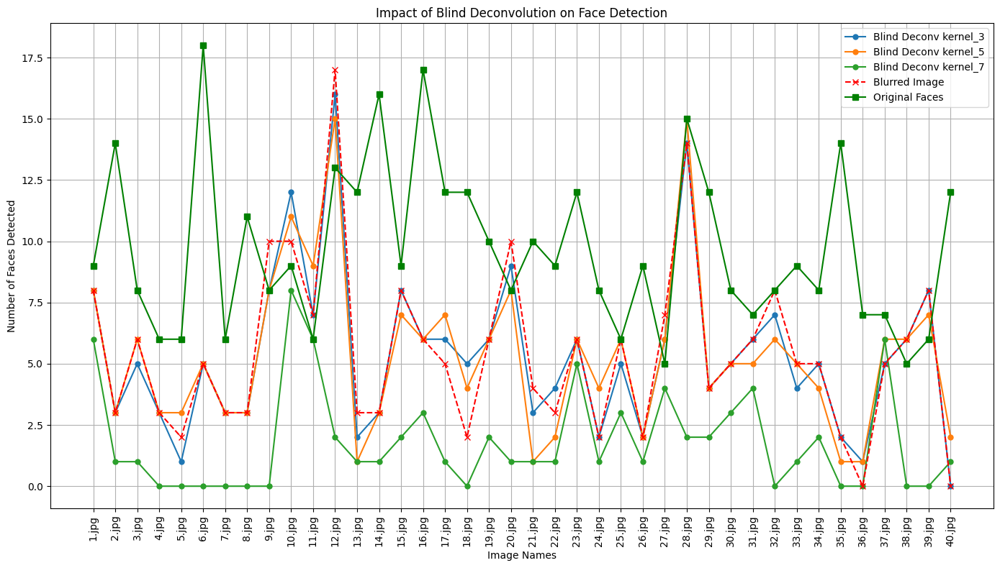

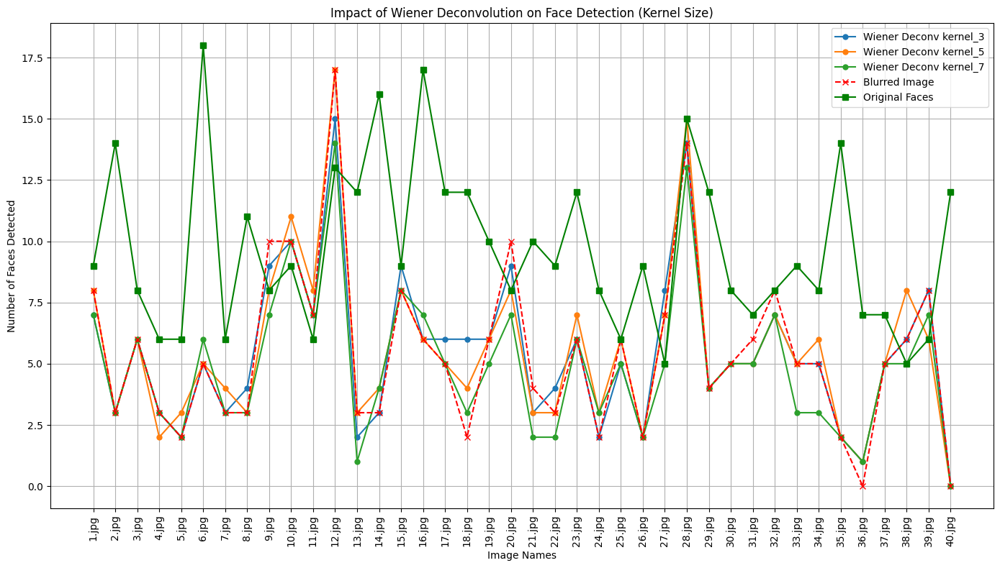

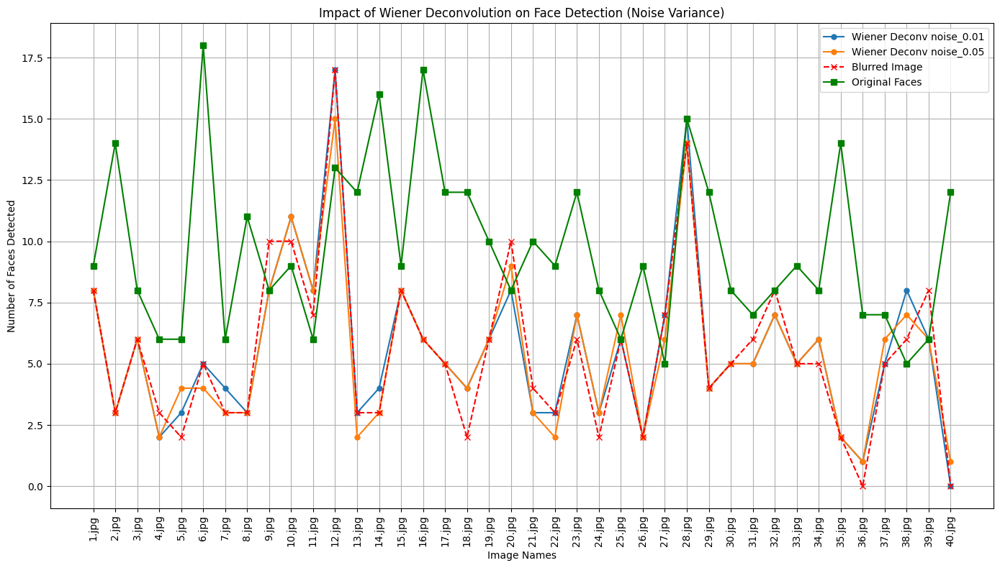

In [48]:
import matplotlib.pyplot as plt

# Extract relevant columns for plotting
# Image names
image_names = haarcascade_blur_results['image_name']

# Actual faces detected (original)
original_faces = haarcascade_blur_results['num_faces']
blurred_faces = haarcascade_blur_results['faces_detected_in_blurred']

# Blind Deconvolution variations (kernel sizes)
blind_deconv_faces = {
    'kernel_3': haarcascade_blur_results['faces_blindconv_kernel3'],
    'kernel_5': haarcascade_blur_results['faces_blindconv_kernel5'],
    'kernel_7': haarcascade_blur_results['faces_blindconv_kernel7']
}

# Wiener Deconvolution variations (kernel sizes)
wiener_deconv_faces_kernel = {
    'kernel_3': haarcascade_blur_results['faces_wiener_kernel3'],
    'kernel_5': haarcascade_blur_results['faces_wiener_kernel5'],
    'kernel_7': haarcascade_blur_results['faces_wiener_kernel7']
}

# Wiener Deconvolution variations (noise variances)
wiener_deconv_faces_noise = {
    'noise_0.01': haarcascade_blur_results['faces_wiener_noise_0.01'],
    'noise_0.05': haarcascade_blur_results['faces_wiener_noise_0.05']
}

# Plot 1: Blind Deconvolution (Kernel Variation)
plt.figure(figsize=(14, 8))
for kernel, face_counts in blind_deconv_faces.items():
    plt.plot(image_names, face_counts, label=f'Blind Deconv {kernel}', marker='o', linestyle='-', markersize=5)

plt.plot(image_names, blurred_faces, label="Blurred Image", color='red', linestyle='--', marker='x')
plt.plot(image_names, original_faces, label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Blind Deconvolution on Face Detection')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot 2: Wiener Deconvolution (Kernel Variation)
plt.figure(figsize=(14, 8))
for kernel, face_counts in wiener_deconv_faces_kernel.items():
    plt.plot(image_names, face_counts, label=f'Wiener Deconv {kernel}', marker='o', linestyle='-', markersize=5)

plt.plot(image_names, blurred_faces, label="Blurred Image", color='red', linestyle='--', marker='x')
plt.plot(image_names, original_faces, label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Wiener Deconvolution on Face Detection (Kernel Size)')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot 3: Wiener Deconvolution (Noise Variance Variation)
plt.figure(figsize=(14, 8))
for variance, face_counts in wiener_deconv_faces_noise.items():
    plt.plot(image_names, face_counts, label=f'Wiener Deconv {variance}', marker='o', linestyle='-', markersize=5)

plt.plot(image_names, blurred_faces, label="Blurred Image", color='red', linestyle='--', marker='x')
plt.plot(image_names, original_faces, label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Wiener Deconvolution on Face Detection (Noise Variance)')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


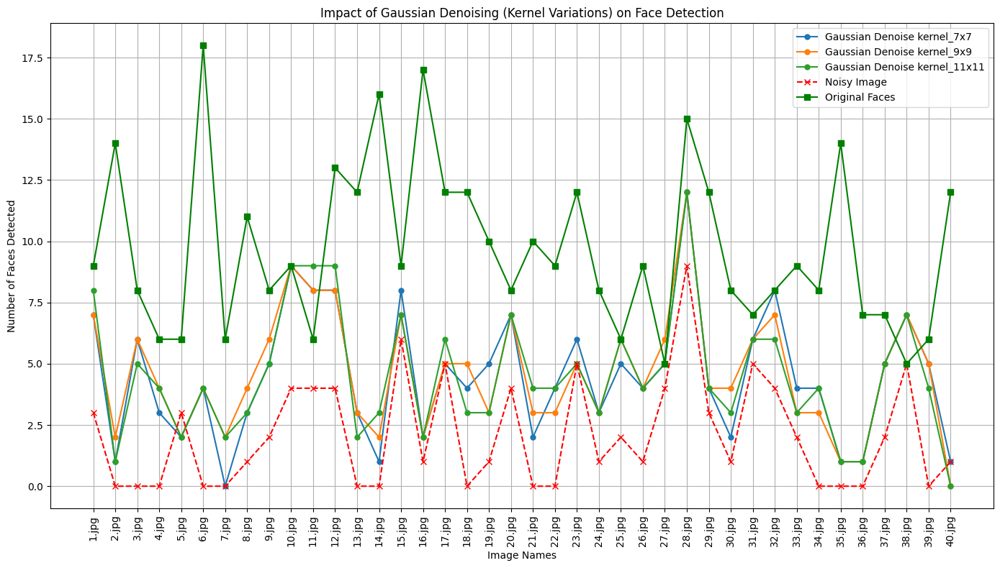

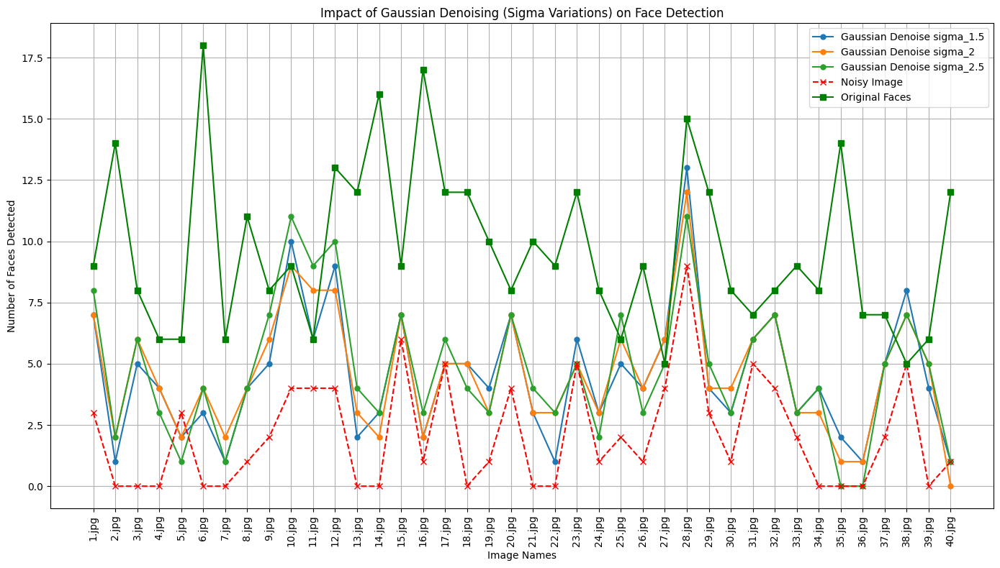

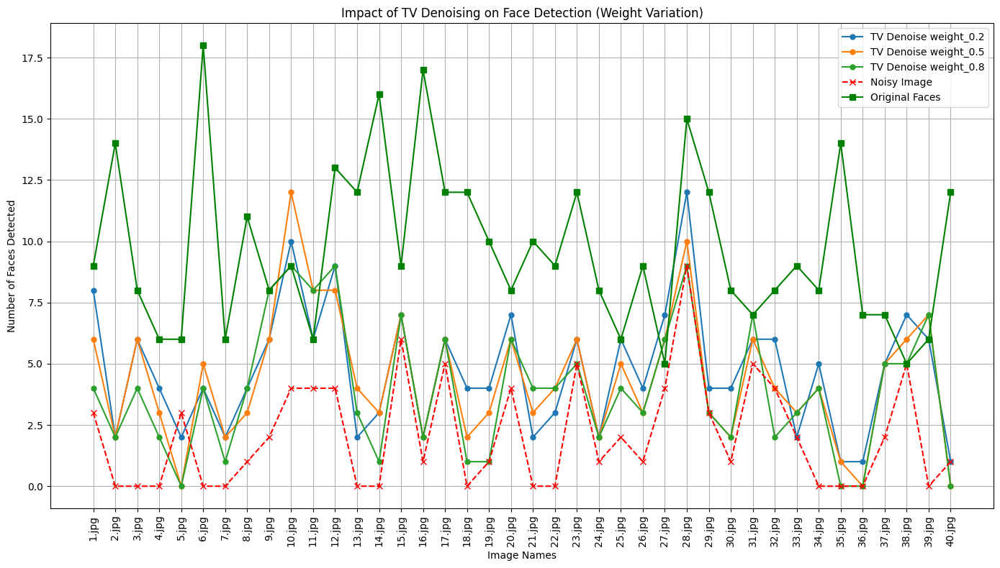

In [50]:
import matplotlib.pyplot as plt

# Extract relevant columns for plotting
# Image names
image_names = haarcascade_denoising_results['image_name']

# Actual faces detected (original)
original_faces = haarcascade_denoising_results['num_faces']
noisy_faces = haarcascade_denoising_results['faces_detected_in_noisy']

# Gaussian Denoising variations
gaussian_denoised_faces = {
    'kernel_7x7': haarcascade_denoising_results['gaussian_kernel_7'],
    'kernel_9x9': haarcascade_denoising_results['gaussian_kernel_9'],
    'kernel_11x11': haarcascade_denoising_results['gaussian_kernel_11'],
    'sigma_1.5': haarcascade_denoising_results['gaussian_sigma_1.5'],
    'sigma_2': haarcascade_denoising_results['gaussian_sigma_2'],
    'sigma_2.5': haarcascade_denoising_results['gaussian_sigma_2.5']
}

# TV Denoising variations
tv_denoised_faces = {
    'weight_0.2': haarcascade_denoising_results['tv_weight_0.2'],
    'weight_0.5': haarcascade_denoising_results['tv_weight_0.5'],
    'weight_0.8': haarcascade_denoising_results['tv_weight_0.8']
}

# Plot 1: Gaussian Denoising (Kernel Variations)
plt.figure(figsize=(14, 8))
for variation, face_counts in gaussian_denoised_faces.items():
    if 'kernel' in variation:  # Only select kernel variations
        plt.plot(image_names, face_counts, label=f'Gaussian Denoise {variation}', marker='o', linestyle='-', markersize=5)

plt.plot(image_names, noisy_faces, label="Noisy Image", color='red', linestyle='--', marker='x')
plt.plot(image_names, original_faces, label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Gaussian Denoising (Kernel Variations) on Face Detection')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot 2: Gaussian Denoising (Sigma Variations)
plt.figure(figsize=(14, 8))
for variation, face_counts in gaussian_denoised_faces.items():
    if 'sigma' in variation:  # Only select sigma variations
        plt.plot(image_names, face_counts, label=f'Gaussian Denoise {variation}', marker='o', linestyle='-', markersize=5)

plt.plot(image_names, noisy_faces, label="Noisy Image", color='red', linestyle='--', marker='x')
plt.plot(image_names, original_faces, label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Gaussian Denoising (Sigma Variations) on Face Detection')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


# Plot 2: TV Denoising (Weight Variation)
plt.figure(figsize=(14, 8))
for variation, face_counts in tv_denoised_faces.items():
    plt.plot(image_names, face_counts, label=f'TV Denoise {variation}', marker='o', linestyle='-', markersize=5)

plt.plot(image_names, noisy_faces, label="Noisy Image", color='red', linestyle='--', marker='x')
plt.plot(image_names, original_faces, label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of TV Denoising on Face Detection (Weight Variation)')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


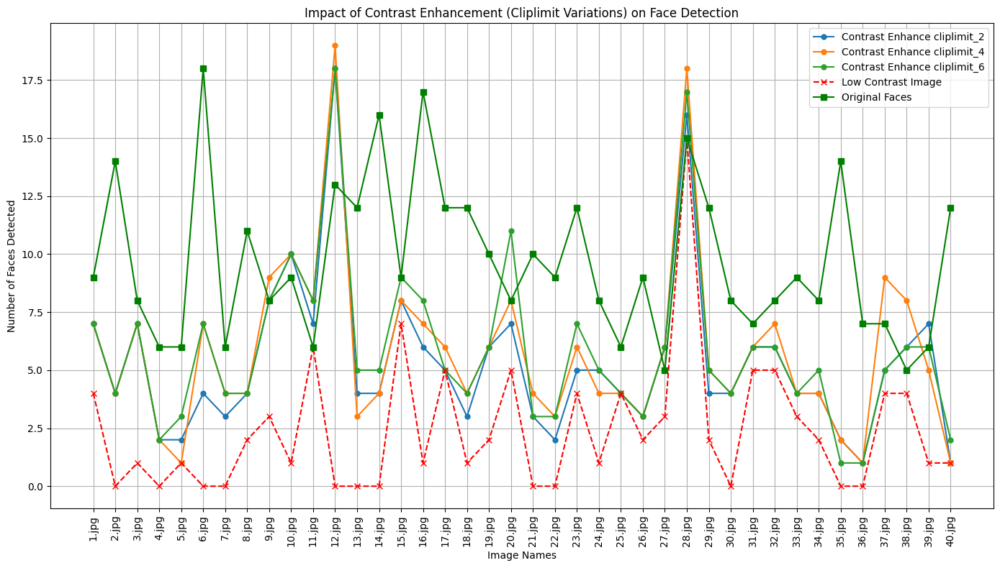

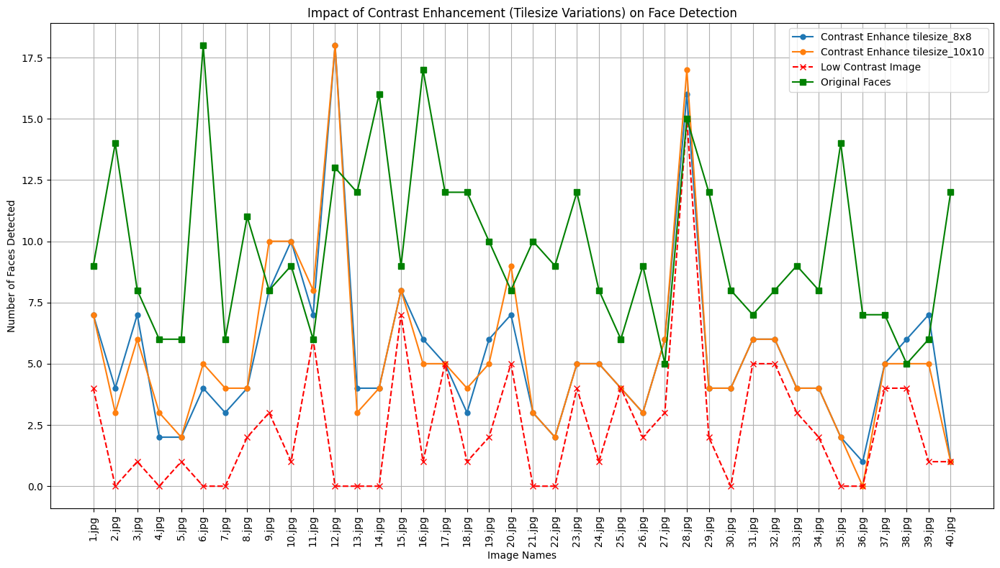

In [51]:
import matplotlib.pyplot as plt

# Extract relevant columns for plotting
# Image names
image_names = haarcascade_contrast_results['image_name']

# Actual faces detected (original)
original_faces = haarcascade_contrast_results['num_faces']
bad_contrast_faces = haarcascade_contrast_results['faces_detected_in_badcontrast']

# Cliplimit Denoising variations
cliplimit_denoised_faces = {
    'cliplimit_2': haarcascade_contrast_results['faces_cliplimit_cliplimit_2'],
    'cliplimit_4': haarcascade_contrast_results['faces_cliplimit_cliplimit_4'],
    'cliplimit_6': haarcascade_contrast_results['faces_cliplimit_cliplimit_6']
}

# Tilesize Denoising variations
tilesize_denoised_faces = {
    'tilesize_8x8': haarcascade_contrast_results['faces_tilesize_tilesize_8'],
    'tilesize_10x10': haarcascade_contrast_results['faces_tilesize_tilesize_10']
}

# Plot 1: Contrast Enhancement (Cliplimit Variations)
plt.figure(figsize=(14, 8))
for variation, face_counts in cliplimit_denoised_faces.items():
    plt.plot(image_names, face_counts, label=f'Contrast Enhance {variation}', marker='o', linestyle='-', markersize=5)

plt.plot(image_names, bad_contrast_faces, label="Low Contrast Image", color='red', linestyle='--', marker='x')
plt.plot(image_names, original_faces, label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Contrast Enhancement (Cliplimit Variations) on Face Detection')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot 2: Contrast Enhancement (Tilesize Variations)
plt.figure(figsize=(14, 8))
for variation, face_counts in tilesize_denoised_faces.items():
    plt.plot(image_names, face_counts, label=f'Contrast Enhance {variation}', marker='o', linestyle='-', markersize=5)

plt.plot(image_names, bad_contrast_faces, label="Low Contrast Image", color='red', linestyle='--', marker='x')
plt.plot(image_names, original_faces, label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Contrast Enhancement (Tilesize Variations) on Face Detection')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


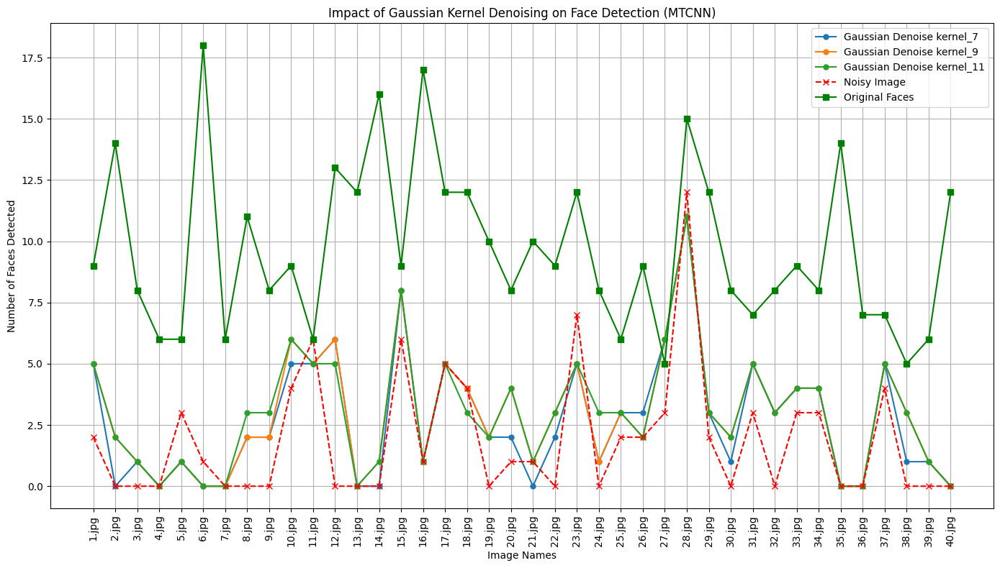

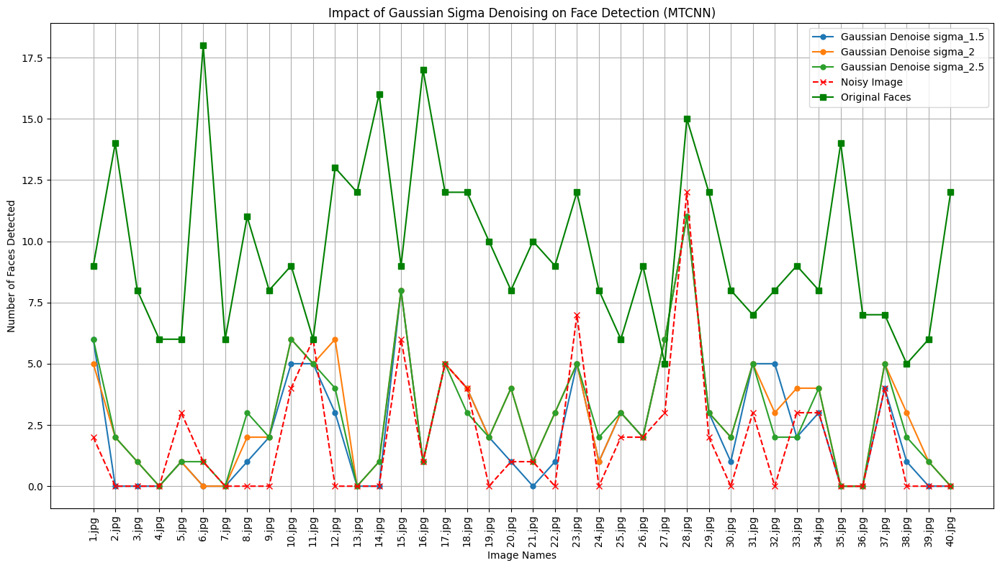

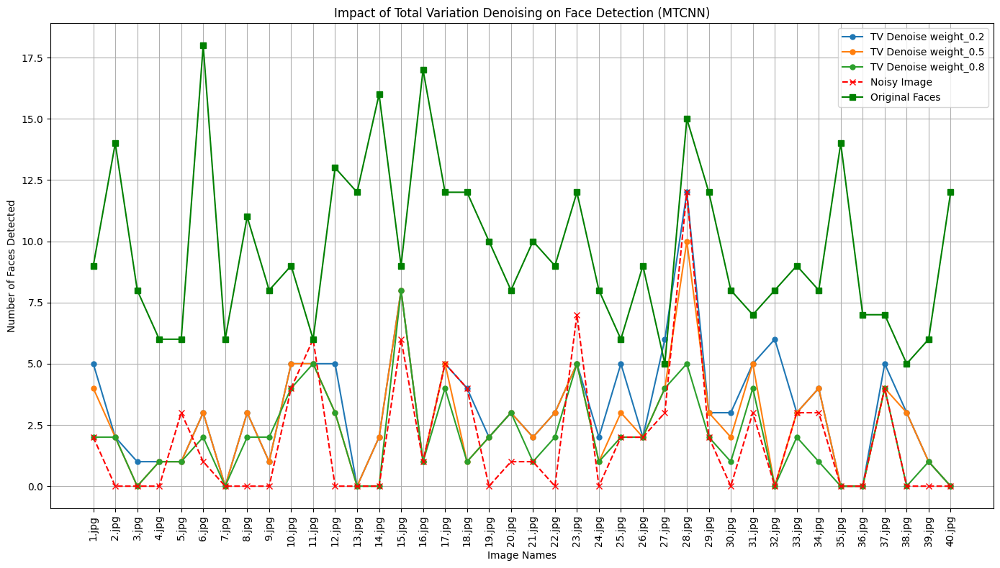

In [41]:
import matplotlib.pyplot as plt

# Extract face counts for each variation
gaussian_face_counts = {
    variation: mtcnn_denoising_results[f'gaussian_{variation}'] for variation in denoised_gaussian_datasets
}

# Plot for Gaussian Kernel Variations
plt.figure(figsize=(14, 8))
kernel_variations = [var for var in gaussian_face_counts if 'kernel' in var]  # Filter for kernel-based variations

for variation in kernel_variations:
    plt.plot(mtcnn_denoising_results['image_name'], gaussian_face_counts[variation],
             label=f'Gaussian Denoise {variation}', marker='o', linestyle='-', markersize=5)

plt.plot(mtcnn_denoising_results['image_name'], mtcnn_denoising_results['faces_detected_in_noisy'],
         label="Noisy Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_denoising_results['image_name'], mtcnn_denoising_results['num_faces'],
         label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Gaussian Kernel Denoising on Face Detection (MTCNN)')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot for Gaussian Sigma Variations
plt.figure(figsize=(14, 8))
sigma_variations = [var for var in gaussian_face_counts if 'sigma' in var]  # Filter for sigma-based variations

for variation in sigma_variations:
    plt.plot(mtcnn_denoising_results['image_name'], gaussian_face_counts[variation],
             label=f'Gaussian Denoise {variation}', marker='o', linestyle='-', markersize=5)

plt.plot(mtcnn_denoising_results['image_name'], mtcnn_denoising_results['faces_detected_in_noisy'],
         label="Noisy Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_denoising_results['image_name'], mtcnn_denoising_results['num_faces'],
         label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Gaussian Sigma Denoising on Face Detection (MTCNN)')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Extract face counts for each TV variation
tv_face_counts = {
    variation: mtcnn_denoising_results[f'tv_{variation}'] for variation in denoised_tv_datasets
}

# Plot for TV Denoising (Weight Variations)
plt.figure(figsize=(14, 8))
for variation, face_counts in tv_face_counts.items():
    plt.plot(mtcnn_denoising_results['image_name'], face_counts, label=f'TV Denoise {variation}', marker='o', linestyle='-', markersize=5)

plt.plot(mtcnn_denoising_results['image_name'], mtcnn_denoising_results['faces_detected_in_noisy'], label="Noisy Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_denoising_results['image_name'], mtcnn_denoising_results['num_faces'], label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Total Variation Denoising on Face Detection (MTCNN)')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


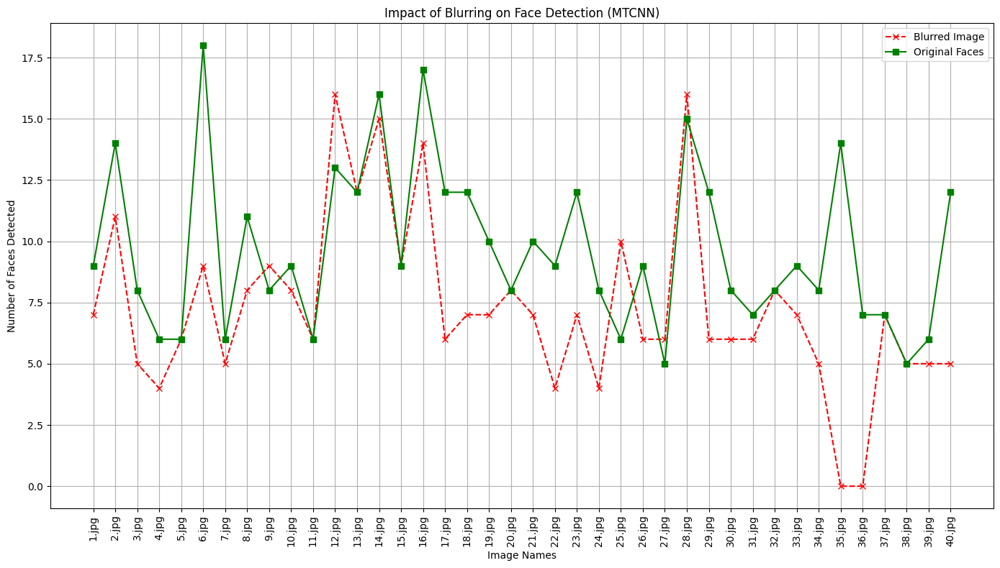

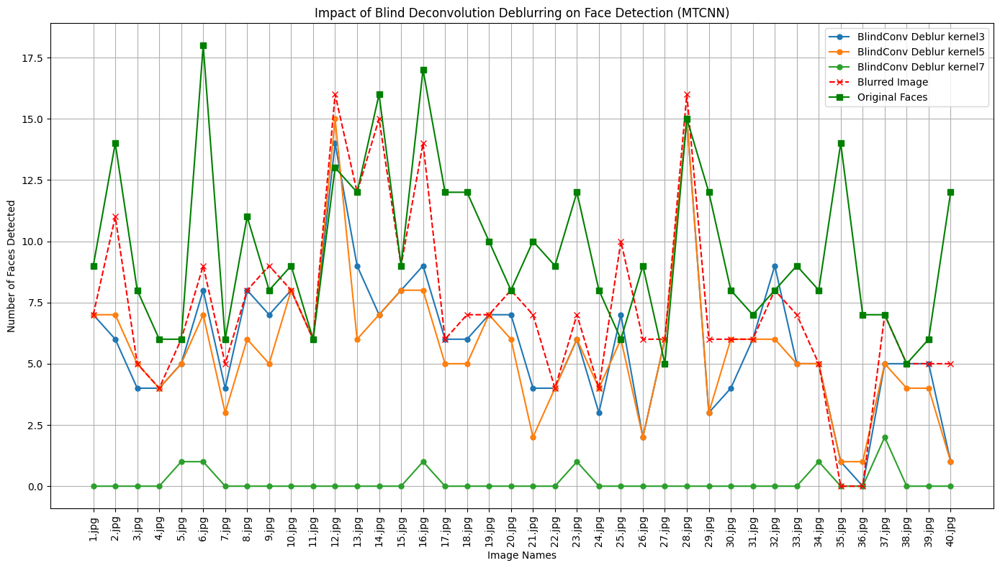

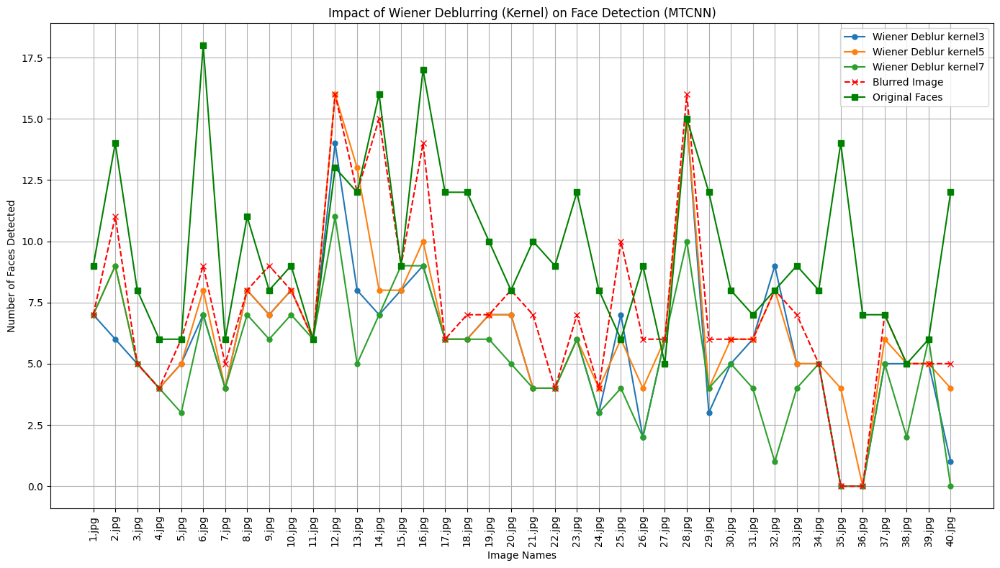

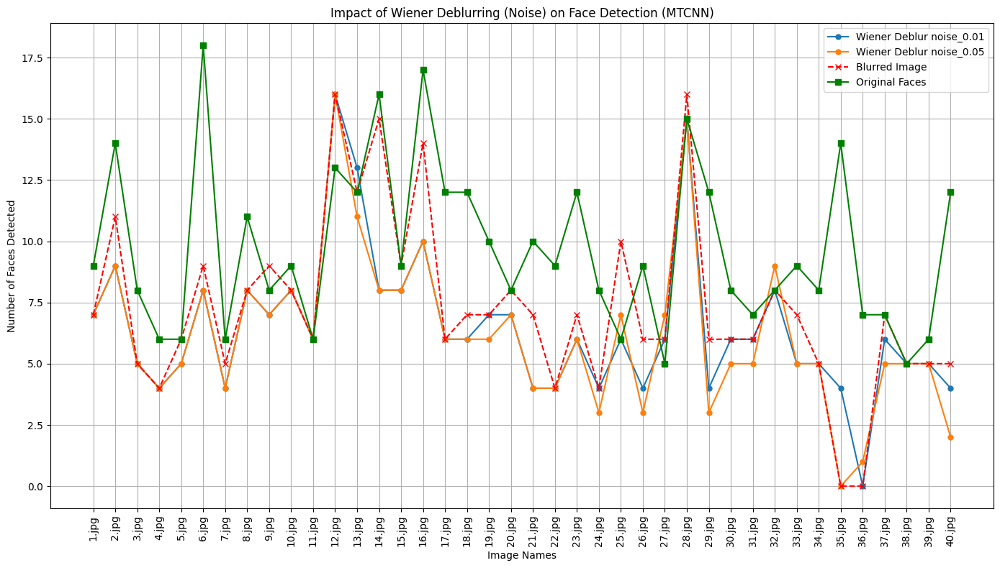

In [42]:
import matplotlib.pyplot as plt

# Prepare the data for plotting
blurred_face_counts = mtcnn_blur_results['faces_detected_in_blurred']
blindconv_face_counts = {kernel: mtcnn_blur_results[f'faces_blindconv_{kernel}'] for kernel in deblurred_blindconv_datasets}
wiener_kernel_face_counts = {kernel: mtcnn_blur_results[f'faces_wiener_{kernel}'] for kernel in deblurred_wiener_kernel_datasets}
wiener_noise_face_counts = {noise_var: mtcnn_blur_results[f'faces_wiener_{noise_var}'] for noise_var in deblurred_wiener_noise_datasets}

# Plot for Blurred Images
plt.figure(figsize=(14, 8))
plt.plot(mtcnn_blur_results['image_name'], blurred_face_counts, label="Blurred Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_blur_results['image_name'], mtcnn_blur_results['num_faces'], label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Blurring on Face Detection (MTCNN)')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot for Blind Deconvolution Deblurring
plt.figure(figsize=(14, 8))
for kernel, face_counts in blindconv_face_counts.items():
    plt.plot(mtcnn_blur_results['image_name'], face_counts, label=f'BlindConv Deblur {kernel}', marker='o', linestyle='-', markersize=5)

plt.plot(mtcnn_blur_results['image_name'], blurred_face_counts, label="Blurred Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_blur_results['image_name'], mtcnn_blur_results['num_faces'], label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Blind Deconvolution Deblurring on Face Detection (MTCNN)')
plt.xticks(rotation=90)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot for Wiener Deblurring (Kernel Variations)
plt.figure(figsize=(14, 8))
for kernel, face_counts in wiener_kernel_face_counts.items():
    plt.plot(mtcnn_blur_results['image_name'], face_counts, label=f'Wiener Deblur {kernel}', marker='o', linestyle='-', markersize=5)

plt.plot(mtcnn_blur_results['image_name'], blurred_face_counts, label="Blurred Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_blur_results['image_name'], mtcnn_blur_results['num_faces'], label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Wiener Deblurring (Kernel) on Face Detection (MTCNN)')
plt.xticks(rotation=90)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot for Wiener Deblurring (Noise Variations)
plt.figure(figsize=(14, 8))
for noise_var, face_counts in wiener_noise_face_counts.items():
    plt.plot(mtcnn_blur_results['image_name'], face_counts, label=f'Wiener Deblur {noise_var}', marker='o', linestyle='-', markersize=5)

plt.plot(mtcnn_blur_results['image_name'], blurred_face_counts, label="Blurred Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_blur_results['image_name'], mtcnn_blur_results['num_faces'], label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Wiener Deblurring (Noise) on Face Detection (MTCNN)')
plt.xticks(rotation=90)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


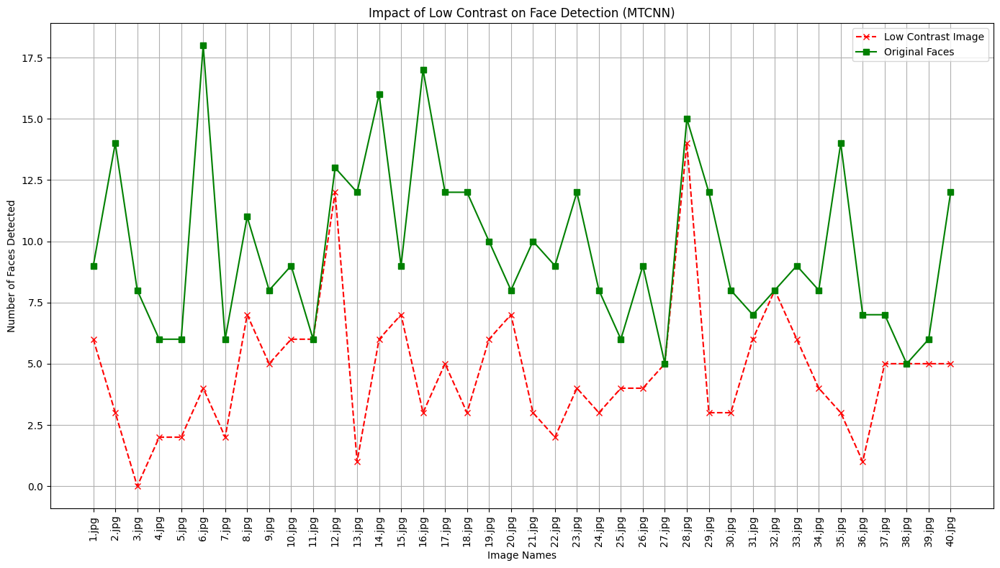

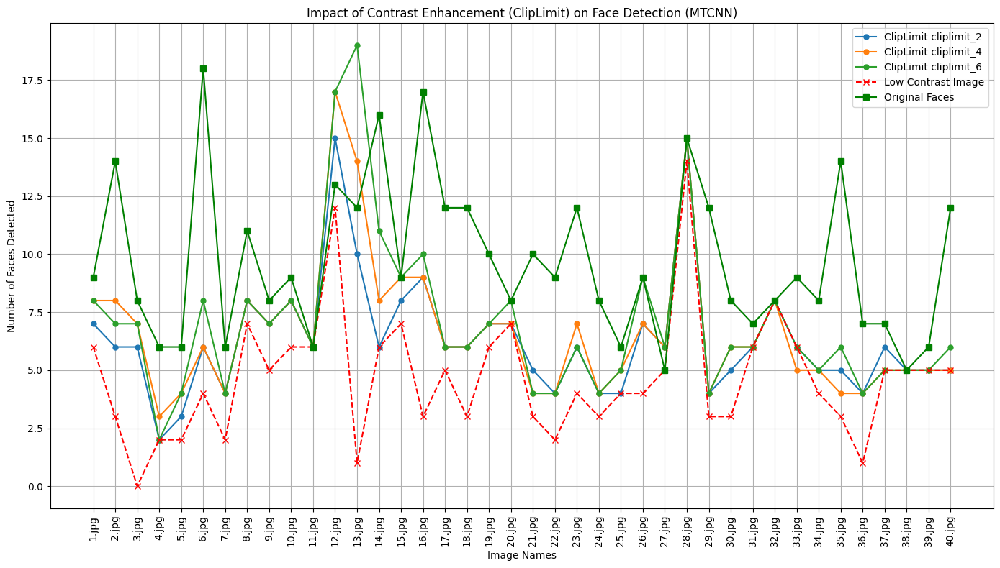

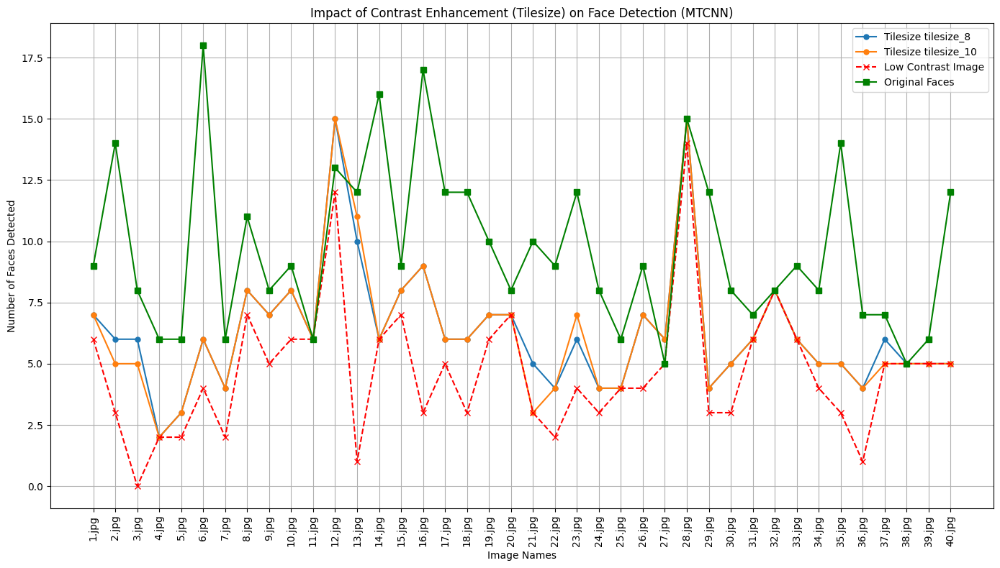

In [43]:
import matplotlib.pyplot as plt

# Prepare the data for plotting
low_contrast_face_counts = mtcnn_contrast_results['faces_detected_in_badcontrast']
cliplimit_face_counts = {clip: mtcnn_contrast_results[f'faces_cliplimit_{clip}'] for clip in cliplimit_variations}
tilesize_face_counts = {tilesize: mtcnn_contrast_results[f'faces_tilesize_{tilesize}'] for tilesize in tilesize_variations}

# Plot for Low Contrast Images
plt.figure(figsize=(14, 8))
plt.plot(mtcnn_contrast_results['image_name'], low_contrast_face_counts, label="Low Contrast Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_contrast_results['image_name'], mtcnn_contrast_results['num_faces'], label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Low Contrast on Face Detection (MTCNN)')
plt.xticks(rotation=90)  # Rotate image names for better readability
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot for ClipLimit Variations
plt.figure(figsize=(14, 8))
for clip, face_counts in cliplimit_face_counts.items():
    plt.plot(mtcnn_contrast_results['image_name'], face_counts, label=f'ClipLimit {clip}', marker='o', linestyle='-', markersize=5)

plt.plot(mtcnn_contrast_results['image_name'], low_contrast_face_counts, label="Low Contrast Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_contrast_results['image_name'], mtcnn_contrast_results['num_faces'], label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Contrast Enhancement (ClipLimit) on Face Detection (MTCNN)')
plt.xticks(rotation=90)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot for Tilesize Variations
plt.figure(figsize=(14, 8))
for tilesize, face_counts in tilesize_face_counts.items():
    plt.plot(mtcnn_contrast_results['image_name'], face_counts, label=f'Tilesize {tilesize}', marker='o', linestyle='-', markersize=5)

plt.plot(mtcnn_contrast_results['image_name'], low_contrast_face_counts, label="Low Contrast Image", color='red', linestyle='--', marker='x')
plt.plot(mtcnn_contrast_results['image_name'], mtcnn_contrast_results['num_faces'], label="Original Faces", color='green', linestyle='-', marker='s')

plt.xlabel('Image Names')
plt.ylabel('Number of Faces Detected')
plt.title('Impact of Contrast Enhancement (Tilesize) on Face Detection (MTCNN)')
plt.xticks(rotation=90)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
